In [7]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [22]:
import sys
sys.path.append("..")
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

from typing import Optional, Union
from copy import deepcopy
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import norm

from coordination.model.real.vocalic import VocalicModel as VocalicModel
from coordination.model.config_bundle.vocalic import VocalicConfigBundle
from coordination.module.coordination.sigmoid_gaussian_coordination import SigmoidGaussianCoordinationSamples
from coordination.module.coordination.constant_coordination import ConstantCoordination
from coordination.model.model import ModelSamples
from coordination.common.normalization import (normalize_serialized_data_per_feature,
                                               normalize_serialized_data_per_subject_and_feature)
from coordination.inference.inference_data import InferenceData
from coordination.module.module import ModuleSamples

In [27]:
# Functions
def plot_state_space(samples: ModelSamples):
    time_map = samples.component_group_samples["state_space"].time_steps_in_coordination_scale[0]
    subject_indices = samples.component_group_samples["state_space"].subject_indices[0]
    values = samples.component_group_samples["state_space"].values[0]
    fig, axs = plt.subplots(1, 2, figsize=(15,4))	
    axs = axs.flatten()
    for subject in range(3):
        ts_idx = np.array([t for t, s in enumerate(subject_indices) if s == subject])
        ts = np.array([time_map[t] for t in ts_idx])
        ys = values[:, ts_idx]
        axs[0].plot(ts, ys[0], label=f"Subject {subject + 1}", marker="o")
        axs[1].plot(ts, ys[1], label=f"Subject {subject + 1}", marker="o")

    axs[0].set_title("Latent Feature 1")
    axs[1].set_title("Latent Feature 2")
    plt.legend()
    plt.tight_layout()

def plot_observations(samples: ModelSamples):
    time_map = samples.component_group_samples["state_space"].time_steps_in_coordination_scale[0]
    subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
    values = samples.component_group_samples["speech_vocalics"].values[0]
    fig, axs = plt.subplots(1, 2, figsize=(15,4))	
    axs = axs.flatten()
    for i, feature_name in enumerate(["Feature 1", "Feature 2"]):
        for subject in range(3):
            ts_idx = np.array([t for t, s in enumerate(subject_indices) if s == subject])
            ts = np.array([time_map[t] for t in ts_idx])
            ys = values[:, ts_idx]
            axs[i].plot(ts, ys[i], label=f"Subject {subject + 1}", marker="o")
            axs[i].set_title(feature_name)
    plt.legend()
    plt.tight_layout()   

def configure_bundle(num_time_steps: int, coordination: Union[int, float, np.ndarray], noise: float, constant_coordination: bool = False) -> VocalicConfigBundle:
    bundle = VocalicConfigBundle()
    if constant_coordination:
        bundle.constant_coordination = True
        bundle.coordination_samples = ModuleSamples(values=[np.ones(num_time_steps) * coordination])
    else:
        if isinstance(coordination, np.ndarray):
            coordination_series = coordination
        else:
            coordination_series = np.ones(num_time_steps) * coordination        
        bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=[coordination_series])
        
    bundle.num_time_steps_in_coordination_scale = num_time_steps
    bundle.num_vocalic_features = 2
    bundle.state_space_dimension_size = 2
    bundle.state_space_dimension_names = ["Latent Feature 1", "Latent Feature 2"]
    bundle.vocalic_feature_names = ["Feature 1", "Feature 2"]
    bundle.sd_a = noise
    bundle.sd_o = noise
    bundle.weights = [np.array([[1, 0], [0, 5]])] # different scale per feature
    bundle.mean_a0 = np.array([[0,0], [25,25], [50,50]])  # Start at different positions and with different speeds
    
    bundle.observation_normalization = "norm_per_feature"
    return bundle

def update_config_bundle_from_samples(config_bundle: VocalicConfigBundle, samples: ModelSamples):
    # Metadata
    config_bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
    config_bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
    config_bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
    config_bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]

    # Data
    config_bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]

def train(model: VocalicModel, burn_in: int = 2000, num_samples: int = 2000, num_chains: int = 4, recreate_variables: bool = True, show_plots: bool = True) -> InferenceData:
    if recreate_variables:
        model.prepare_for_inference()    
    idata = model.fit(burn_in = burn_in, num_samples = num_samples, num_chains = num_chains)

    if show_plots:
        idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1), marker=None)
        idata.plot_parameter_posterior()
        print(idata.generate_convergence_summary())
    return idata

def predictive_prior(model: VocalicModel):
    model.prepare_for_inference()
    idata = model.prior_predictive()
    
    means, std = idata.average_prior_predictive_samples("speech_vocalics", return_std=True)
    data = idata.trace.observed_data["speech_vocalics"]
    time_steps = np.array(
        [
            int(x.split("#")[1])
            for x in getattr(means, f"speech_vocalics_time").data
        ]
    )
    fig, axs = plt.subplots(2, 2, figsize=(15,8))	
    axs = axs.flatten()
    for i, feature_name in enumerate(["pitch", "intensity", "jitter", "shimmer"]):
        d = data.sel(speech_vocalics_dimension = feature_name)
        m = means.sel(speech_vocalics_dimension = feature_name)
        s = std.sel(speech_vocalics_dimension = feature_name)
        axs[i].plot(time_steps, m, marker="o", label="sampled")
        axs[i].fill_between(time_steps, m - s, m + s, alpha=0.2)
        axs[i].plot(time_steps, d, marker="o", label="observed")
        axs[i].set_title(feature_name)
    plt.legend()
    plt.tight_layout()

# Sampling

## Coordination = 0

In the abcensse of coordination, each subject's component follows it's own dynamics which consists of a constant speed and position governed by a simple movement equation. See, for instance, that the position of the component from subject 3 increases faster than the others given its larger speed.

30
None


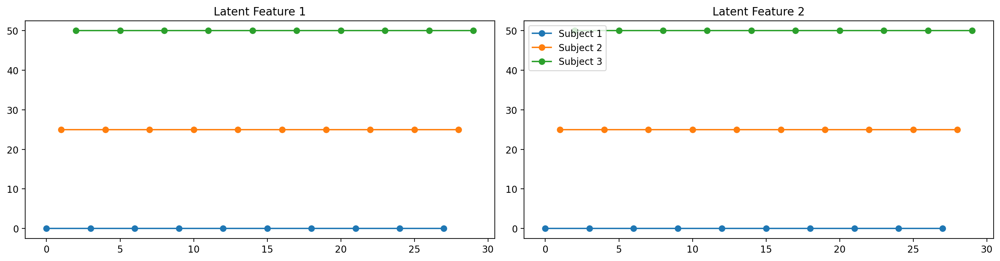

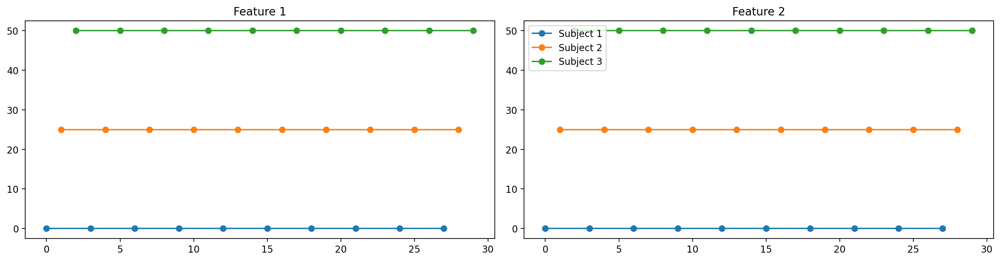

In [29]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0,
    noise=0,
)
model = VocalicModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

## Coordination = 1

When coordination is maximum, the components instantly share the same speed which is a positive number in this example, leading to a constant increase in their position over time. Notice, however, that because we do not blend position, each component moves in its own scale, which would be equivalent to different people having different baselines for their biological signals. For instance, person A may have a natural lower picth than person B. Coordination will unlikely make person B to adopt person's B pitch but it may influence person A to increase their pitch with respect to person A's baseline if person B does the same with respect to their own pitch baseline.

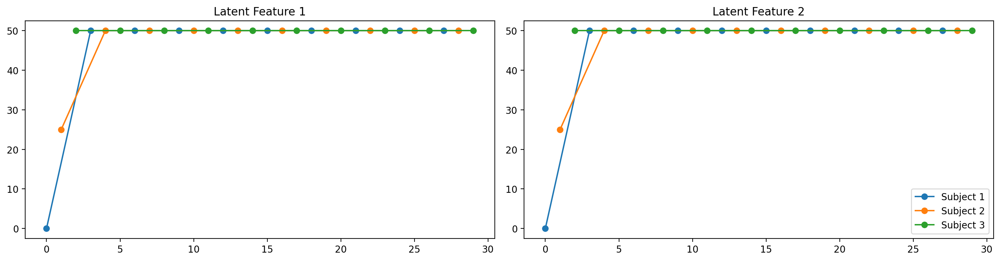

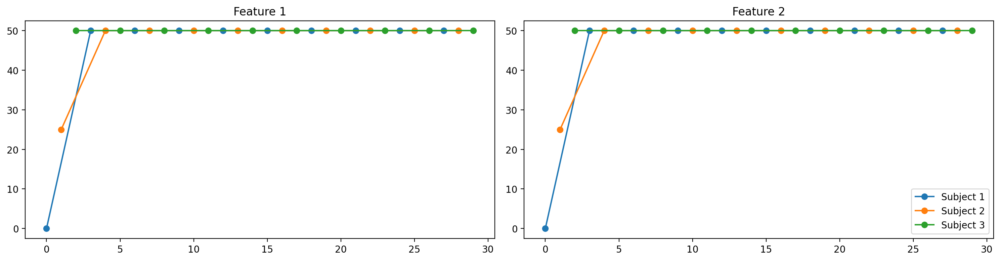

In [44]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=1,
    noise=0
)
model = VocalicModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

## Coordination = 0.2

As we lower coordination, the slower the component's speed converge to a common value but it still does if coordination persists. This tells us that persistent non-zero coordination in this model leads to convergence given enough time and no noise in the system. There's probably an analytical form to find the time when the speeds converge given some conditions (no variance, no gaps etc.).

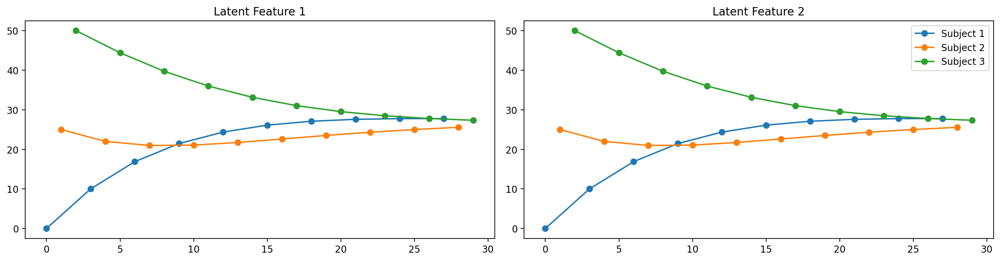

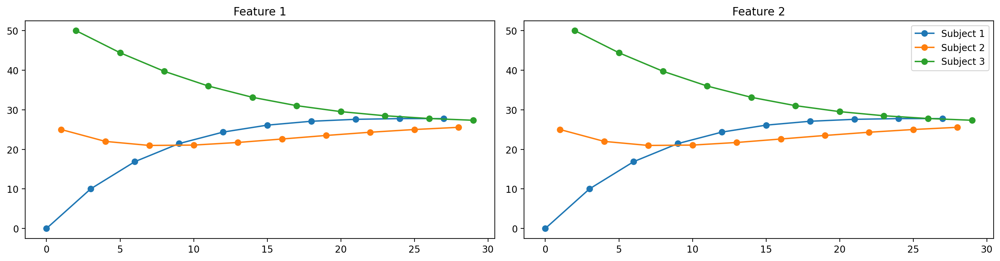

In [45]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0.2,
    noise=0
)
model = VocalicModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

# Normalization

In [46]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0.2,
    noise=0
)
model = VocalicModel(bundle)
samples = model.draw_samples()

## No normalization

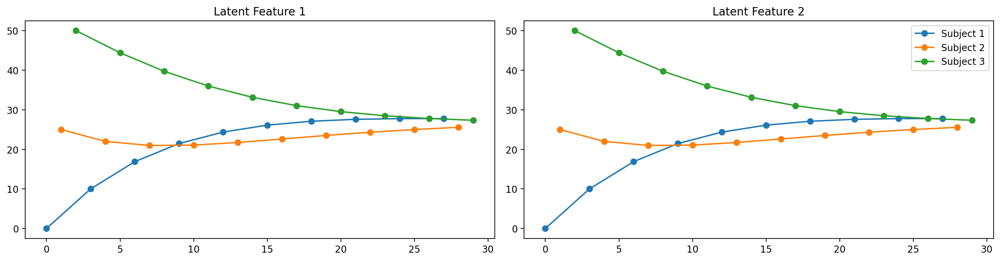

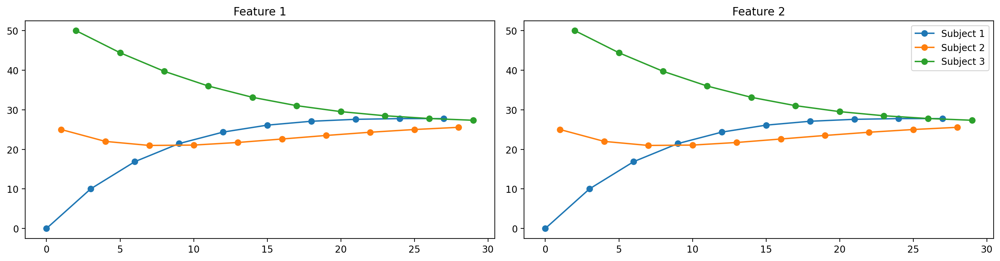

In [47]:
plot_state_space(samples)
plot_observations(samples)

## Normalization per feature

This normalization does not distort the data trend but adjusts each feature to smaller, shared range.

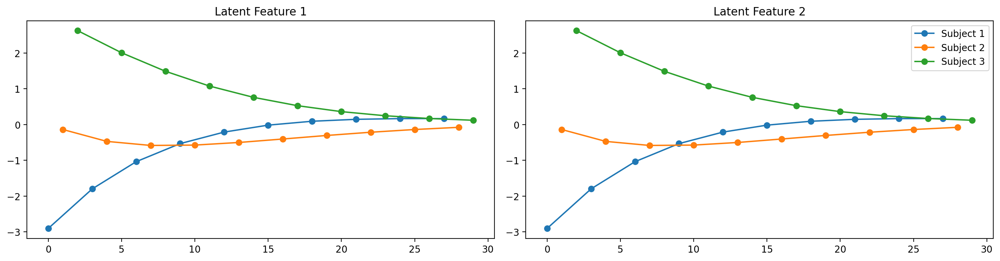

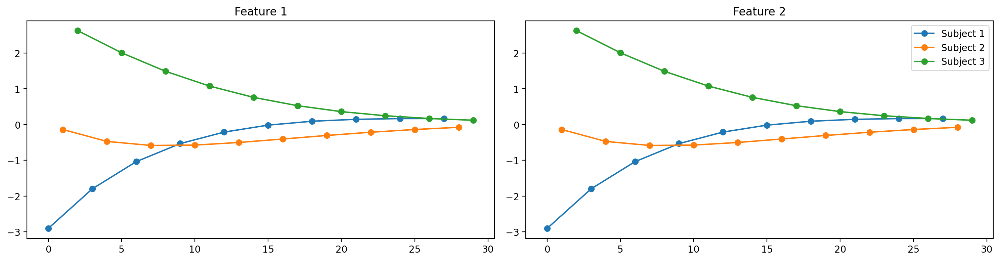

In [48]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["state_space"].values[0] = normalize_serialized_data_per_feature(
    data = samples_copy.component_group_samples["state_space"].values[0])
samples_copy.component_group_samples["speech_vocalics"].values[0] = normalize_serialized_data_per_feature(
    data = samples_copy.component_group_samples["speech_vocalics"].values[0])
plot_state_space(samples_copy)
plot_observations(samples_copy)

## Normalization per subject and feature

This type of normalization distorts data and should be avoided. Instead, we should fit different mean_a0 per subject to account for interpersonal differences.

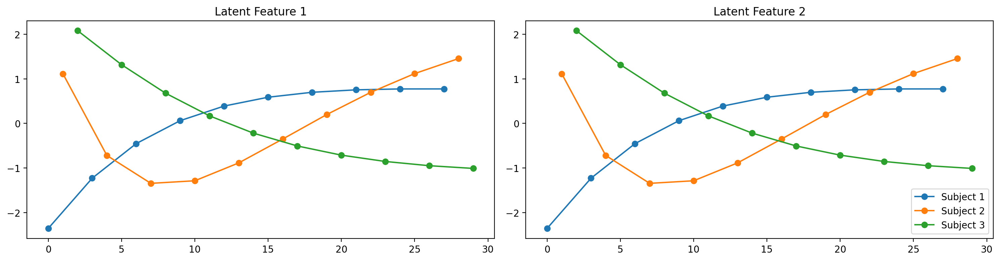

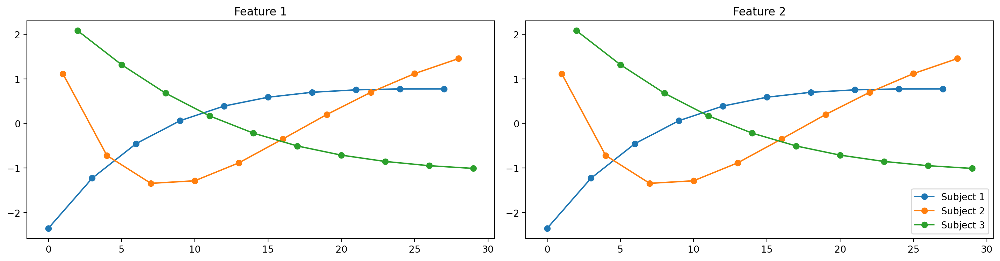

In [49]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["state_space"].values[0] = normalize_serialized_data_per_subject_and_feature(
    data = samples_copy.component_group_samples["state_space"].values[0],
    subject_indices= samples_copy.component_group_samples["state_space"].subject_indices[0],
    num_subjects=3)
samples_copy.component_group_samples["speech_vocalics"].values[0] = normalize_serialized_data_per_subject_and_feature(
    data = samples_copy.component_group_samples["speech_vocalics"].values[0],
    subject_indices= samples_copy.component_group_samples["speech_vocalics"].subject_indices[0],
    num_subjects=3)
plot_state_space(samples_copy)
plot_observations(samples_copy)

# Inference

## a. Constant coordination small noise (0.01)

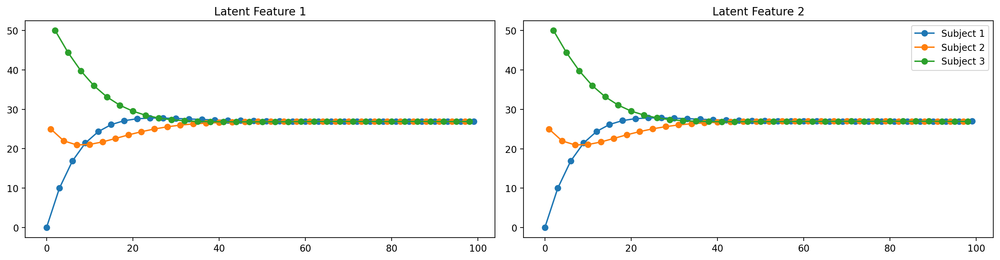

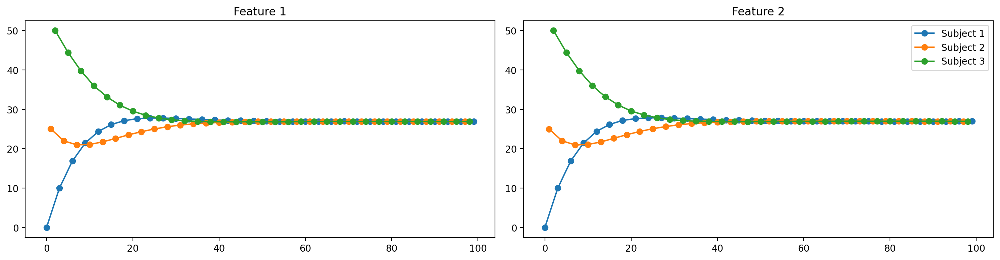

In [50]:
template_bundle_a = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

model = VocalicModel(deepcopy(template_bundle_a))
data_a = model.draw_samples()
update_config_bundle_from_samples(template_bundle_a, data_a)

plot_state_space(data_a)
plot_observations(data_a)

### a1. No given parameters

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 662 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 662 seconds.


                 variable converged  mean_rhat  std_rhat
0   coordination_mean_uc0       yes   1.038452  0.000000
1  unbounded_coordination       yes   1.051404  0.019522
2     state_space_mean_a0       yes   1.005200  0.003451
3             state_space       yes   1.001838  0.001507
4      coordination_sd_uc        no   1.136292  0.000000
5        state_space_sd_a       yes   1.005050  0.001961
6    speech_vocalics_sd_o       yes   1.000563  0.000000
7            coordination       yes   1.051396  0.019510


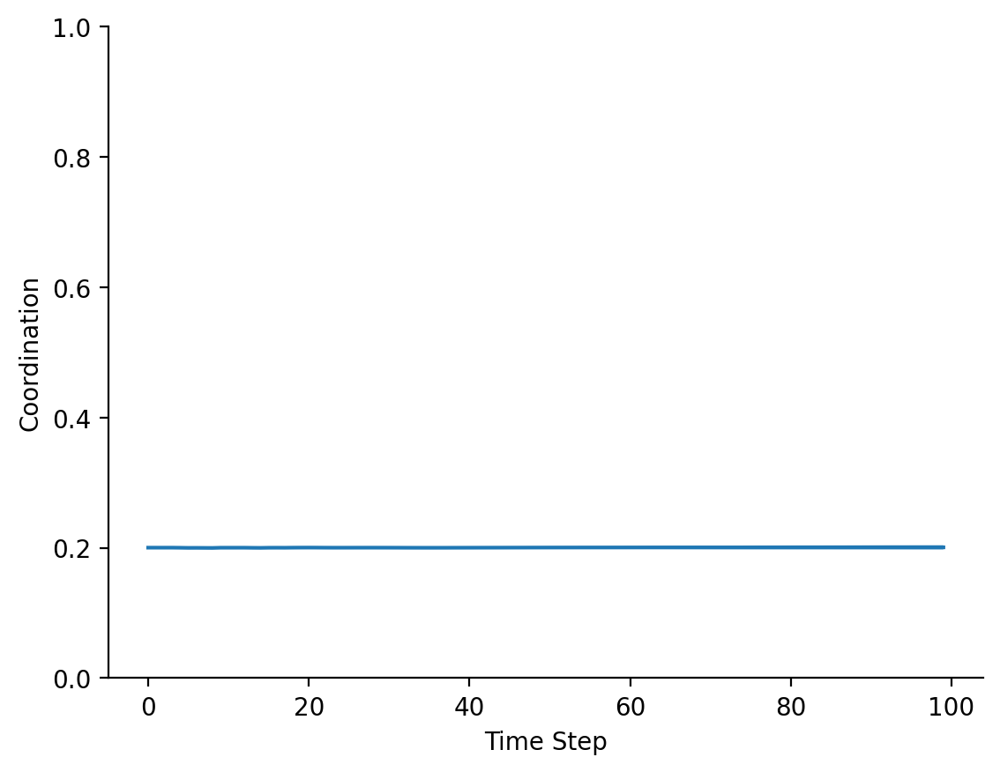

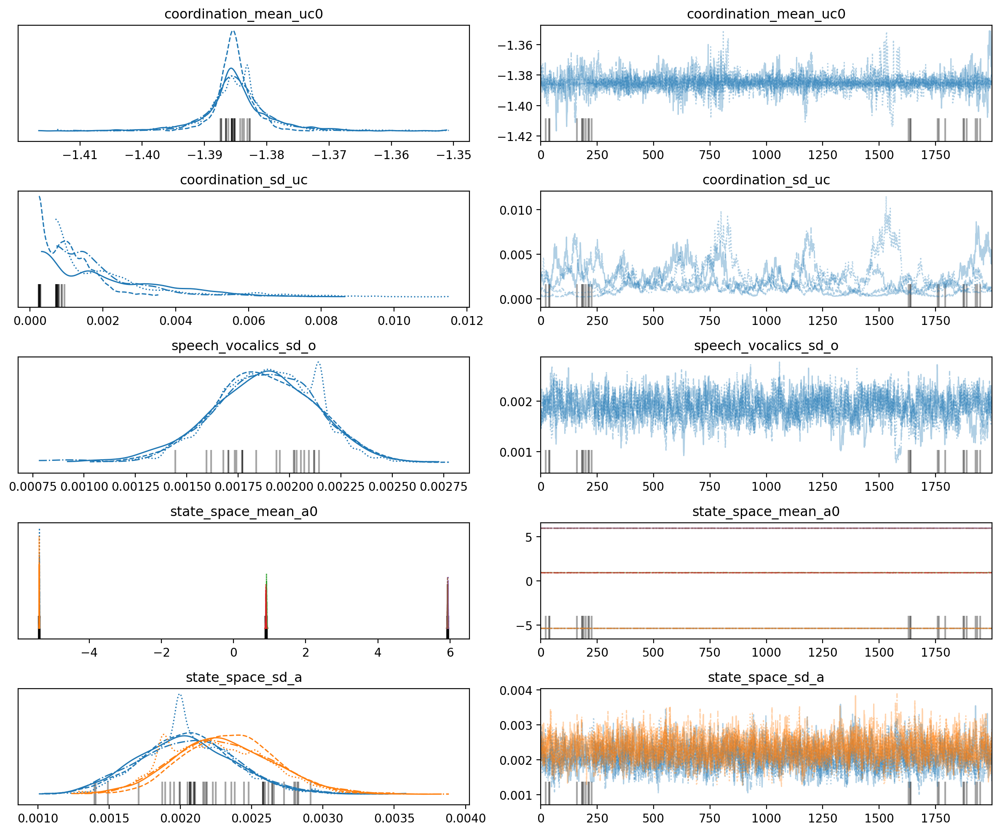

In [51]:
model = VocalicModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.eye(2)] # Important if normalization per feature is used

idata_a1 = train(model)

#### State space estimation

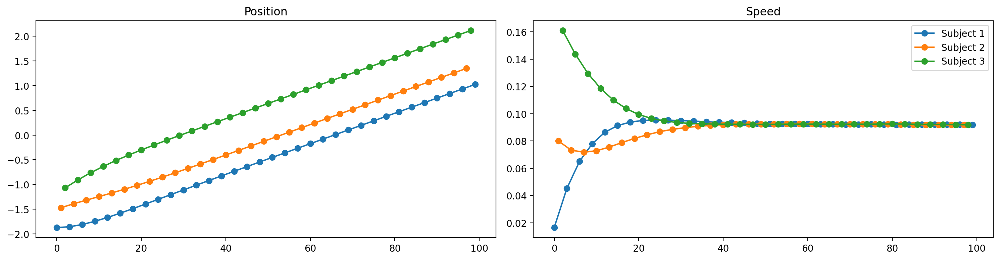

In [35]:
data_cp = deepcopy(data_a)
data_cp.component_group_samples["state_space"].values[0] = idata_a1.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

### a2. Fixed sd_uc = 0.01

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 478 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.000714  0.000000
1  unbounded_coordination   1.007517  0.004580
2     state_space_mean_a0   1.000538  0.000163
3             state_space   1.000416  0.000465
4        state_space_sd_a   1.000571  0.000000
5    speech_vocalics_sd_o   1.000524  0.000000
6            coordination   1.007517  0.004580


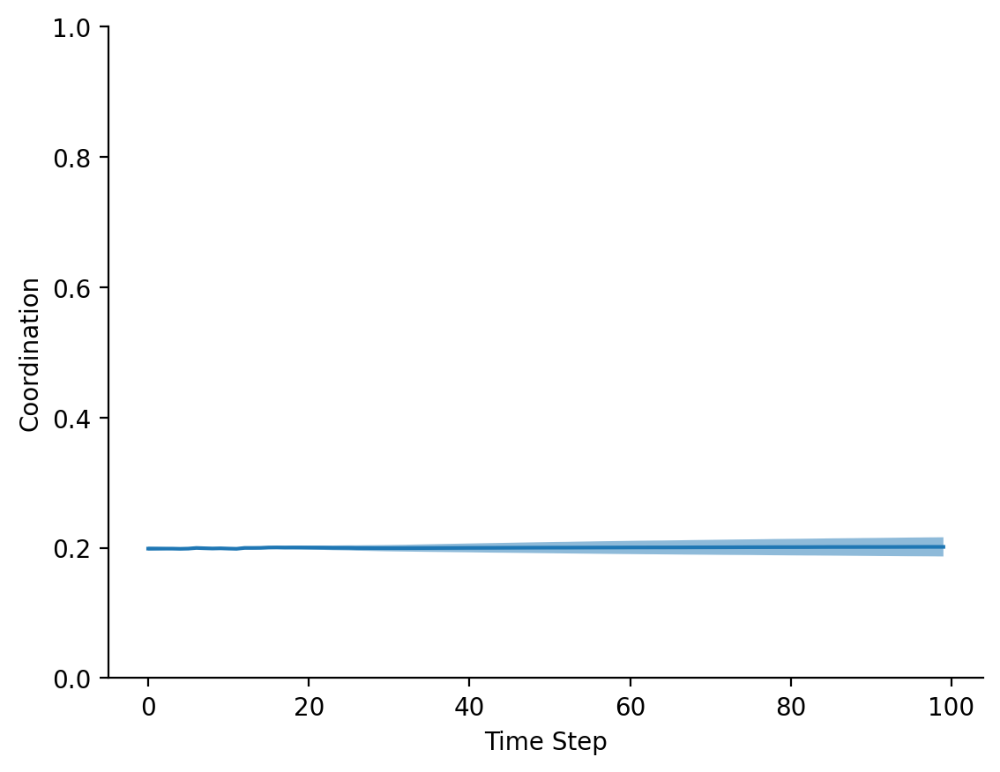

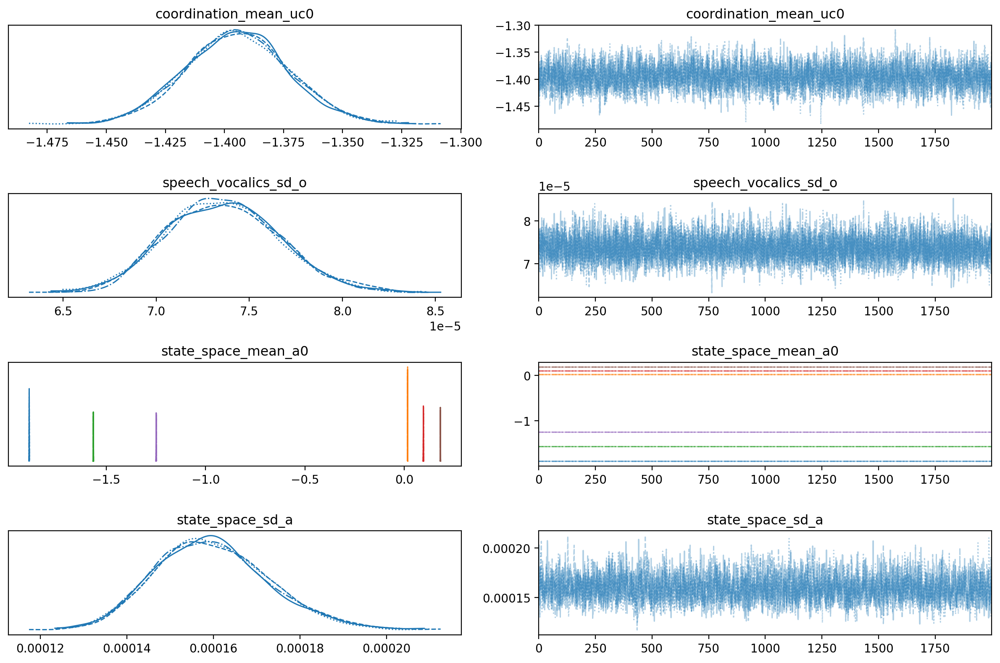

In [30]:
model = VocalicModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.01
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_a2 = train(model)

#### State space estimation

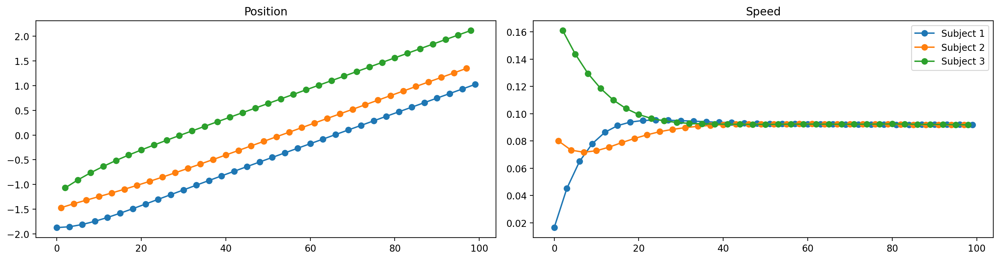

In [36]:
data_cp = deepcopy(data_a)
data_cp.component_group_samples["state_space"].values[0] = idata_a2.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

### a3. Tighter prior for sd_uc

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 677 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.163576  0.000000
1  unbounded_coordination   1.238090  0.194293
2     state_space_mean_a0   1.504137  0.086595
3             state_space   1.303708  0.181547
4      coordination_sd_uc   1.304818  0.000000
5        state_space_sd_a   1.179391  0.000000
6    speech_vocalics_sd_o   1.525709  0.000000
7            coordination   1.237769  0.194342


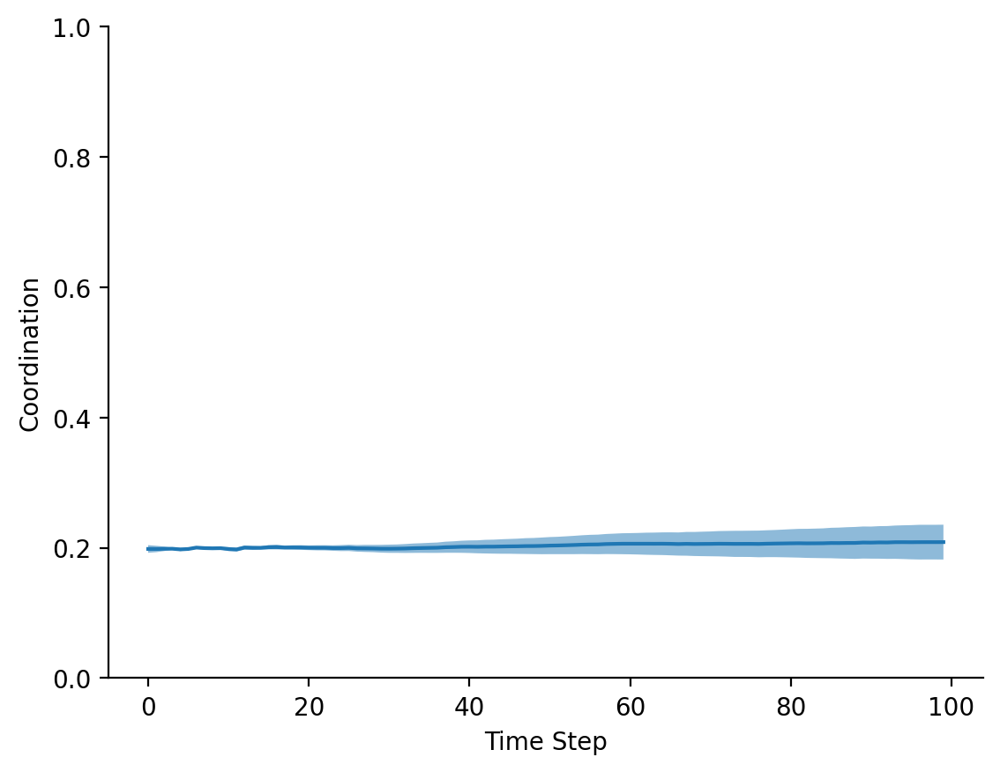

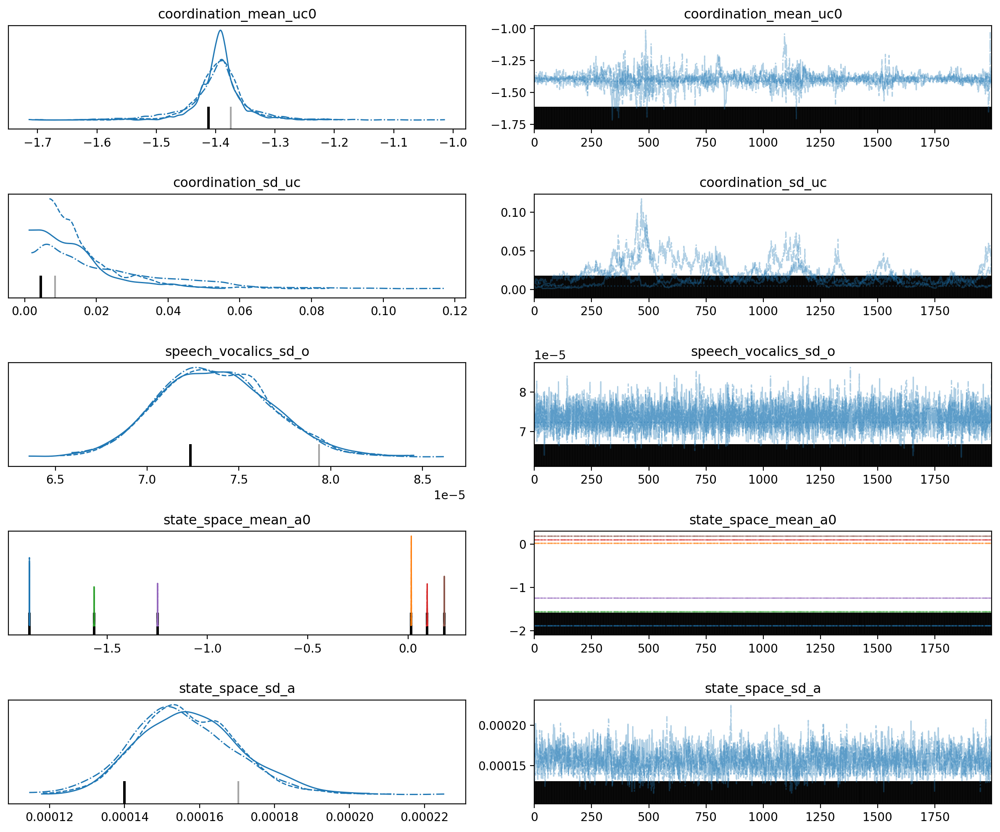

In [31]:
model = VocalicModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.sd_sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_a3 = train(model)

#### State space estimation

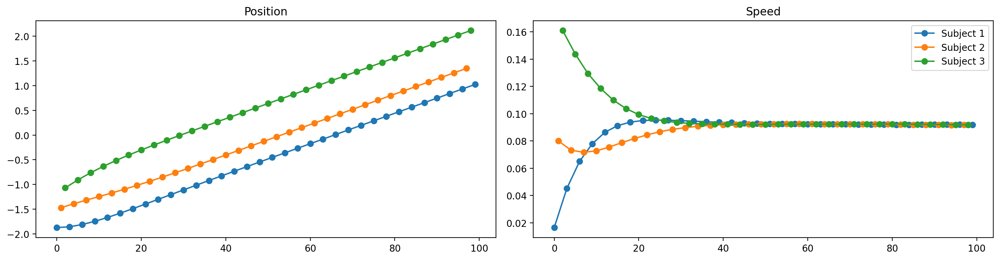

In [37]:
data_cp = deepcopy(data_a)
data_cp.component_group_samples["state_space"].values[0] = idata_a3.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

### a4. No given parameters (longer burn-in)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 1610 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.099979  0.000000
1  unbounded_coordination   1.155244  0.060580
2     state_space_mean_a0   1.011374  0.004938
3             state_space   1.004760  0.004523
4      coordination_sd_uc   1.333576  0.000000
5        state_space_sd_a   1.009064  0.000000
6    speech_vocalics_sd_o   1.000591  0.000000
7            coordination   1.154120  0.059878


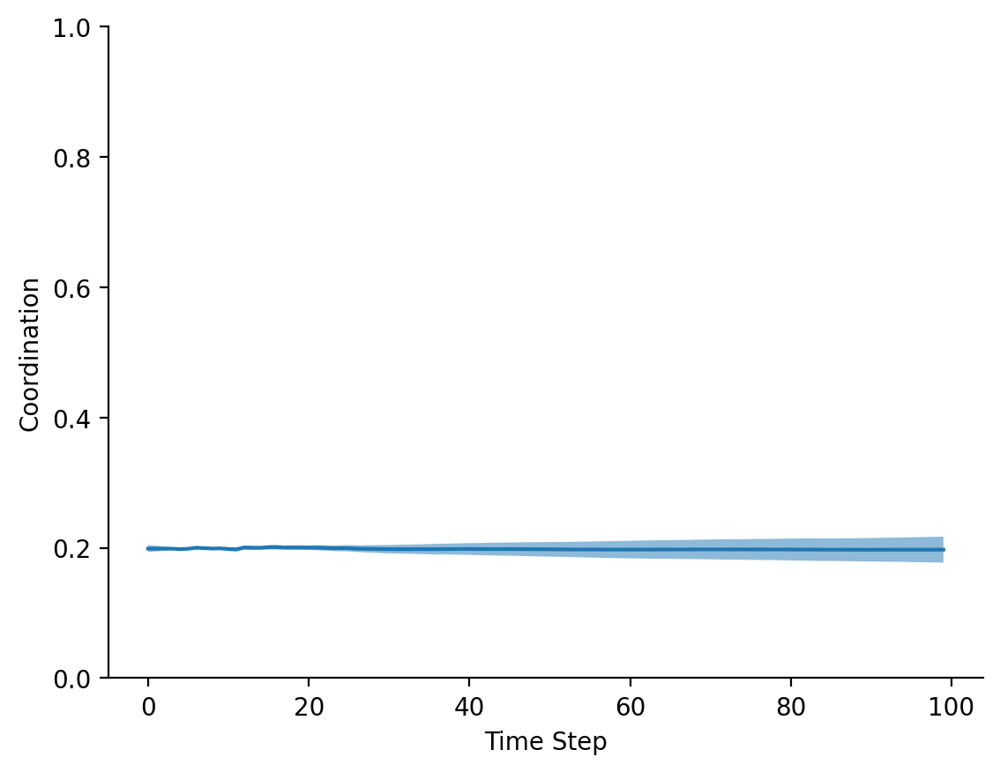

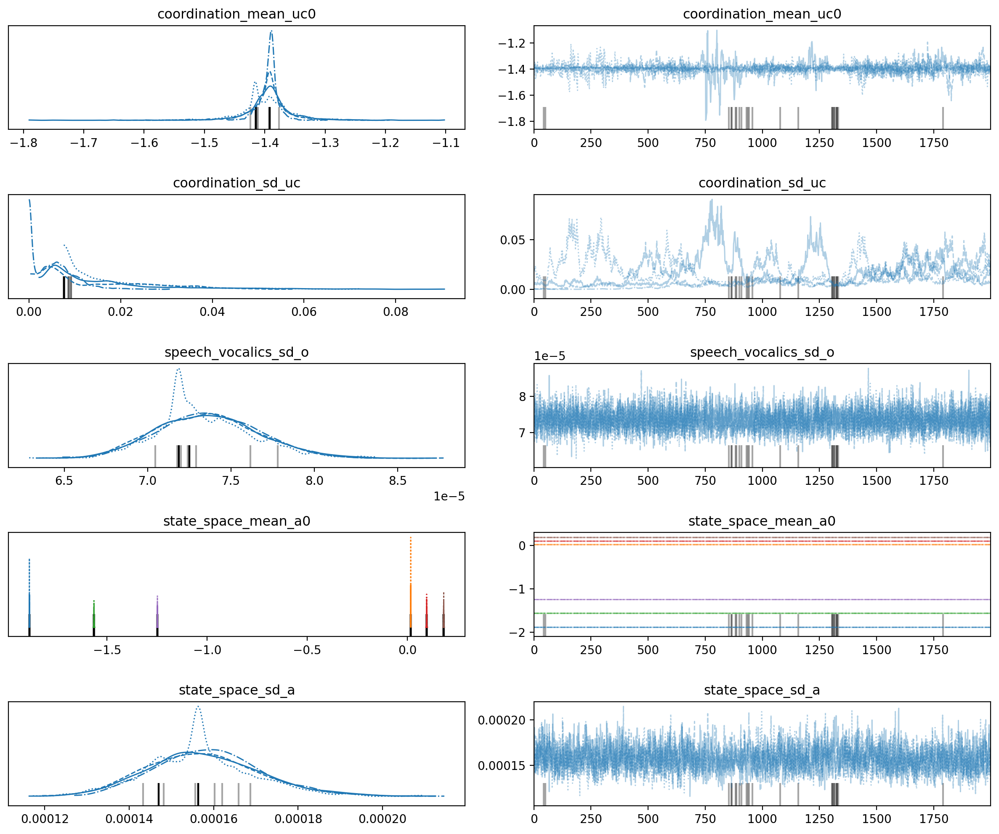

In [32]:
model = VocalicModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_a4 = train(model, burn_in=4000)

#### State space estimation

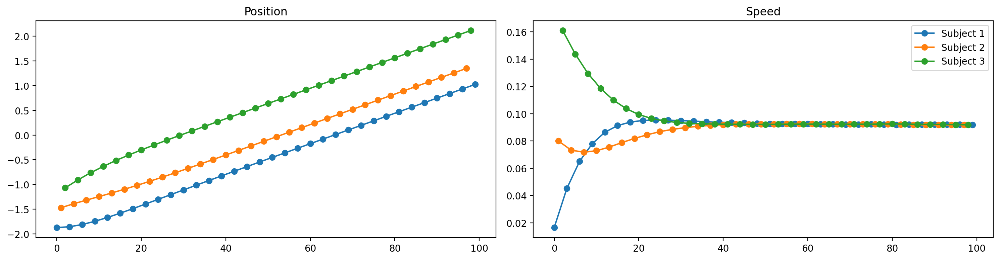

In [38]:
data_cp = deepcopy(data_a)
data_cp.component_group_samples["state_space"].values[0] = idata_a4.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

## b. Constant coordination large noise (1)

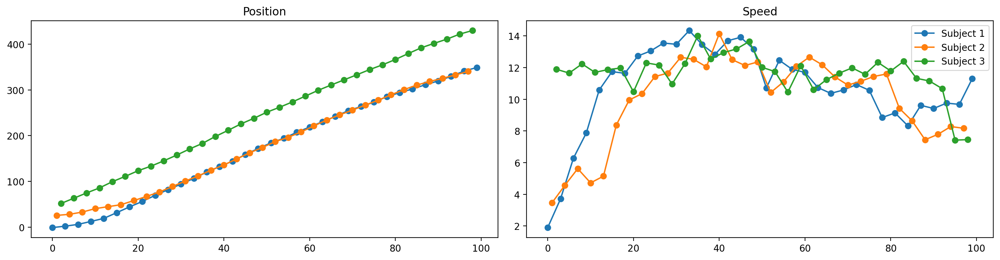

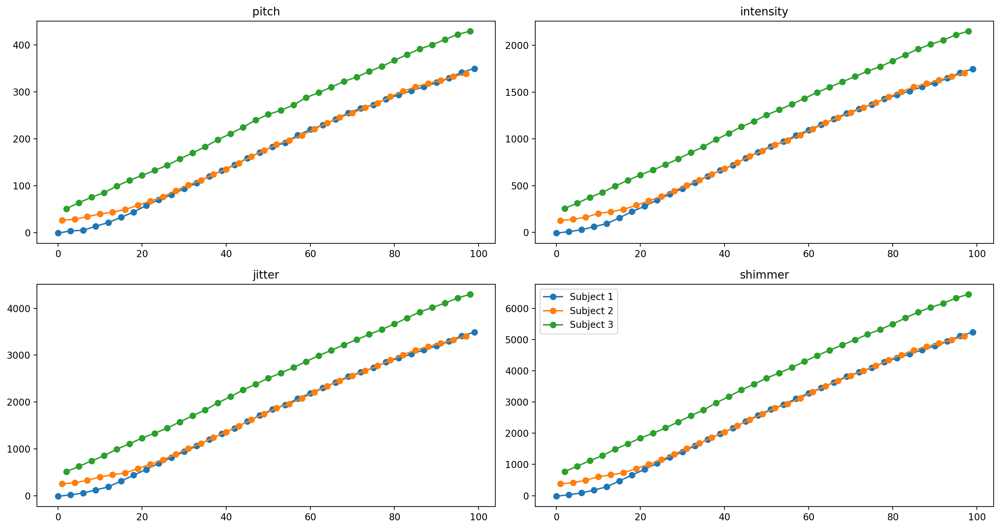

In [40]:
template_bundle_b = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=1
)

model = VocalicModel(deepcopy(template_bundle_b))
data_b = model.draw_samples()
update_config_bundle_from_samples(template_bundle_b, data_b)

plot_state_space(data_b)
plot_observations(data_b)

### b1. No given parameters

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 532 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.105071  0.000000
1  unbounded_coordination   1.074125  0.019507
2     state_space_mean_a0   1.051675  0.036261
3             state_space   1.001547  0.002209
4      coordination_sd_uc   1.331372  0.000000
5        state_space_sd_a   1.032502  0.000000
6    speech_vocalics_sd_o   1.000993  0.000000
7            coordination   1.059884  0.022424


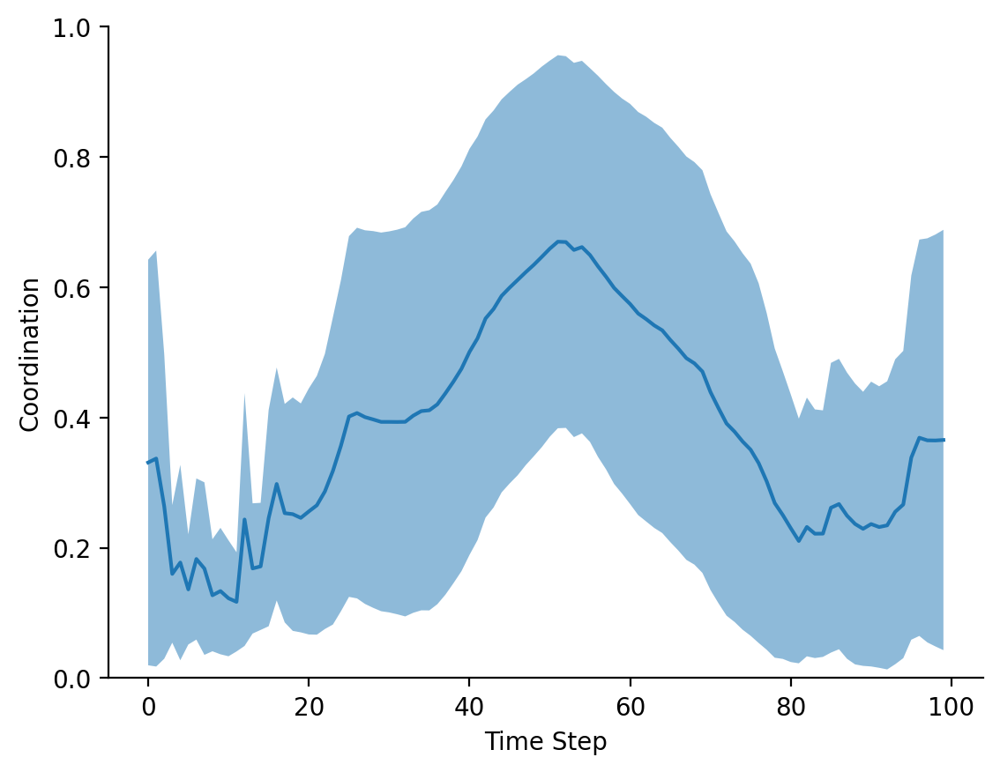

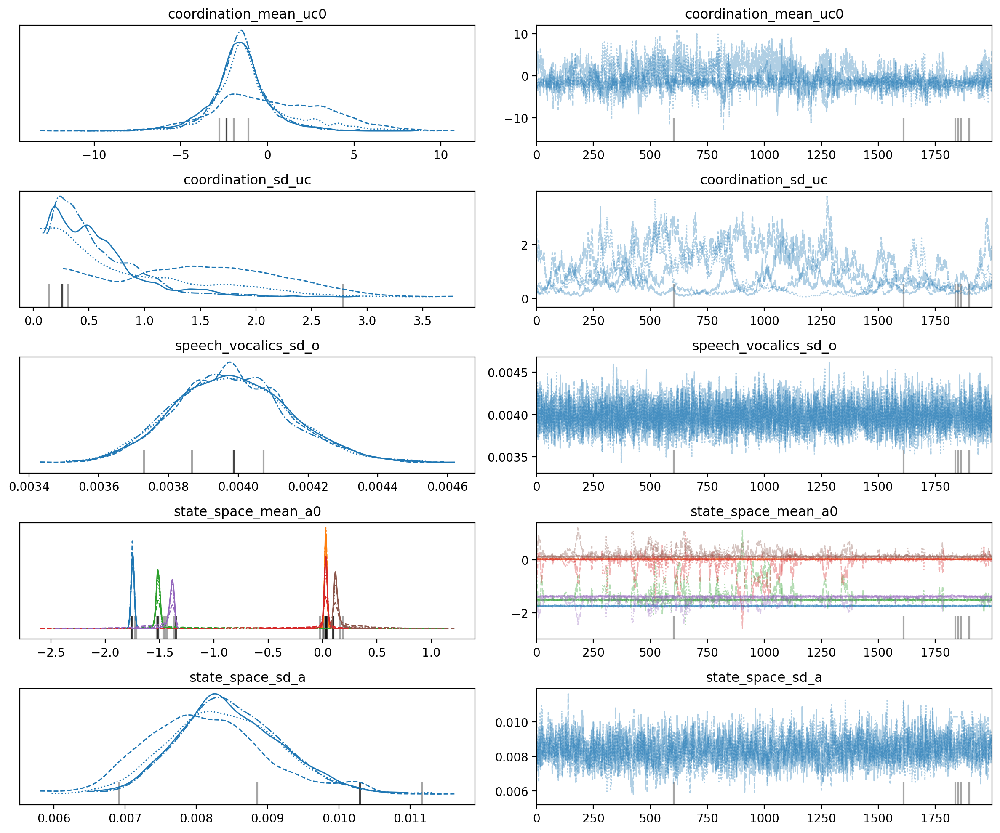

In [42]:
model = VocalicModel(deepcopy(template_bundle_b))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_b1 = train(model)

#### State space estimation

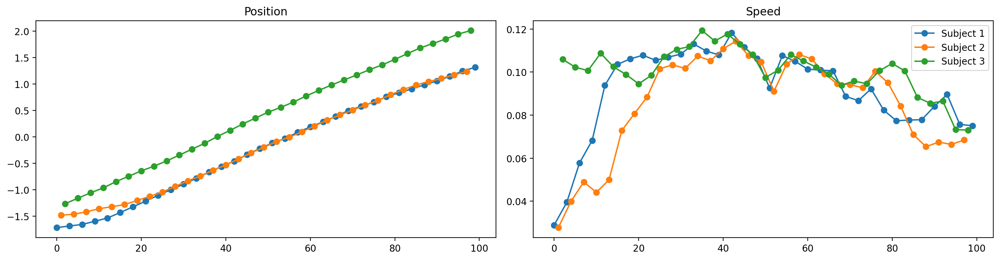

In [43]:
data_cp = deepcopy(data_b)
data_cp.component_group_samples["state_space"].values[0] = idata_b1.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

### b2. Fixed sd_uc = 0.01

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 644 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.271062  0.000000
1  unbounded_coordination   1.265260  0.006325
2     state_space_mean_a0   1.014524  0.016584
3             state_space   1.000828  0.001394
4        state_space_sd_a   1.004467  0.000000
5    speech_vocalics_sd_o   1.000402  0.000000
6            coordination   1.265260  0.006325


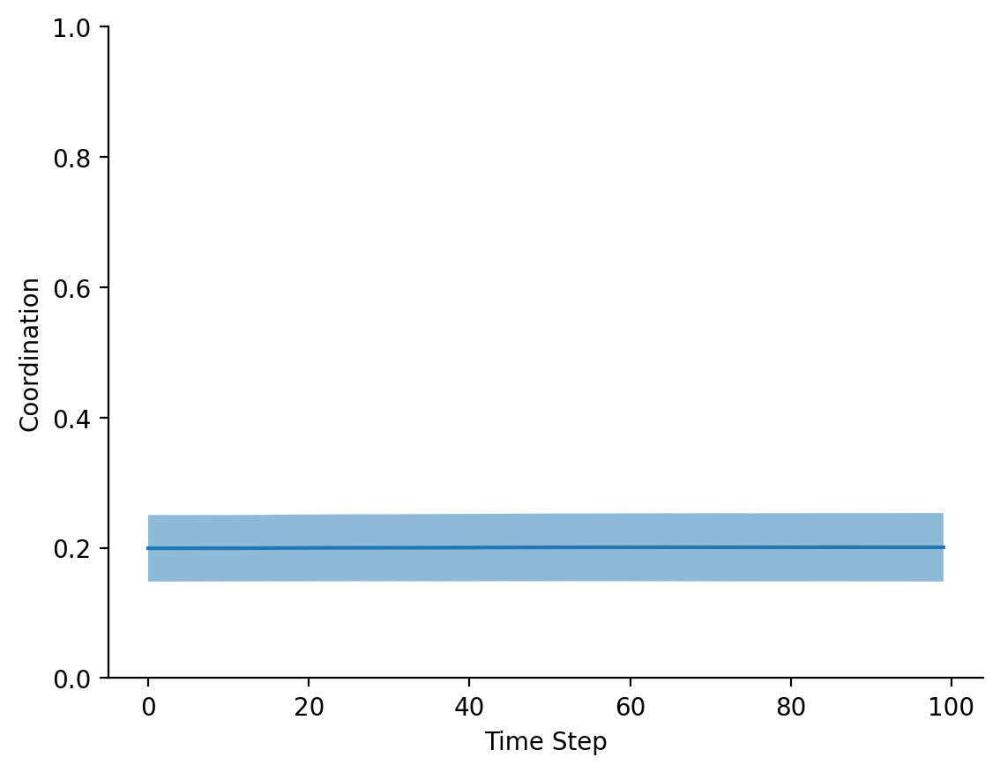

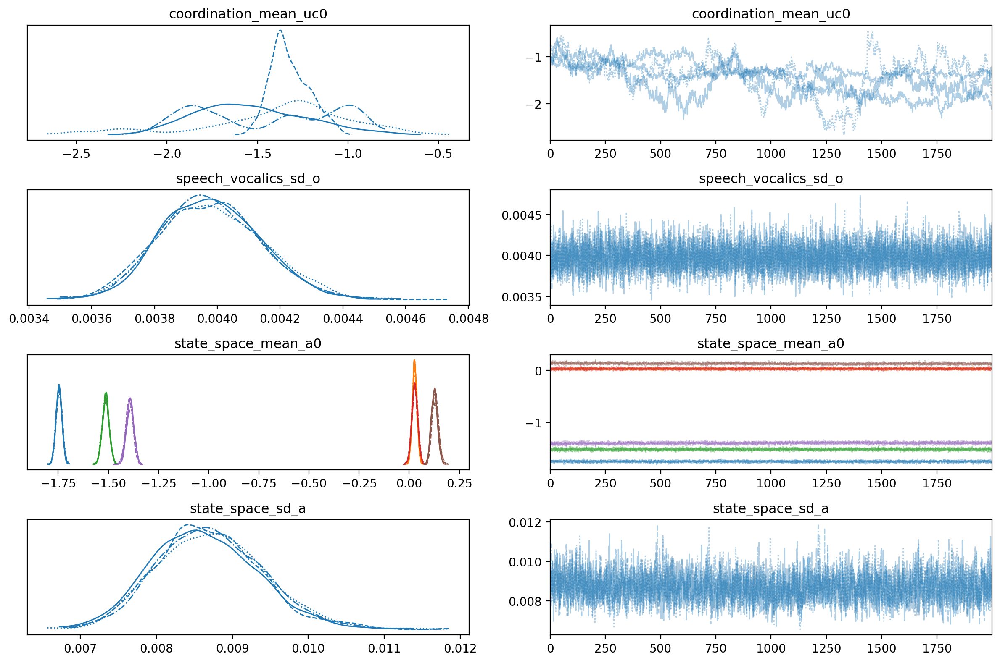

In [44]:
model = VocalicModel(deepcopy(template_bundle_b))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.01
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_b2 = train(model)

#### State space estimation

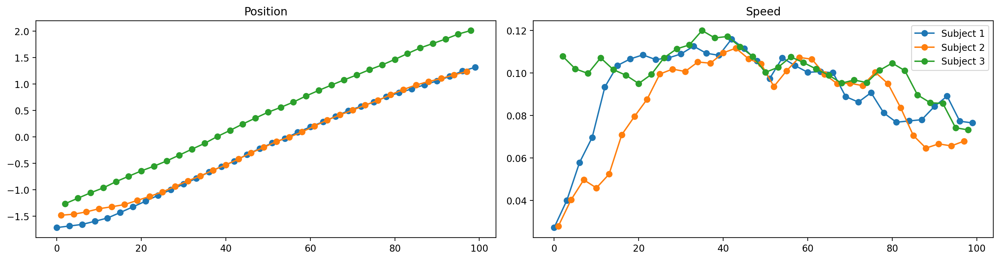

In [45]:
data_cp = deepcopy(data_b)
data_cp.component_group_samples["state_space"].values[0] = idata_b2.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

### b3. Fixed sd_uc = 0.1

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 248 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.002022  0.000000
1  unbounded_coordination   1.008441  0.003383
2     state_space_mean_a0   1.001883  0.001415
3             state_space   1.000537  0.000522
4        state_space_sd_a   1.000912  0.000000
5    speech_vocalics_sd_o   1.000166  0.000000
6            coordination   1.007677  0.003137


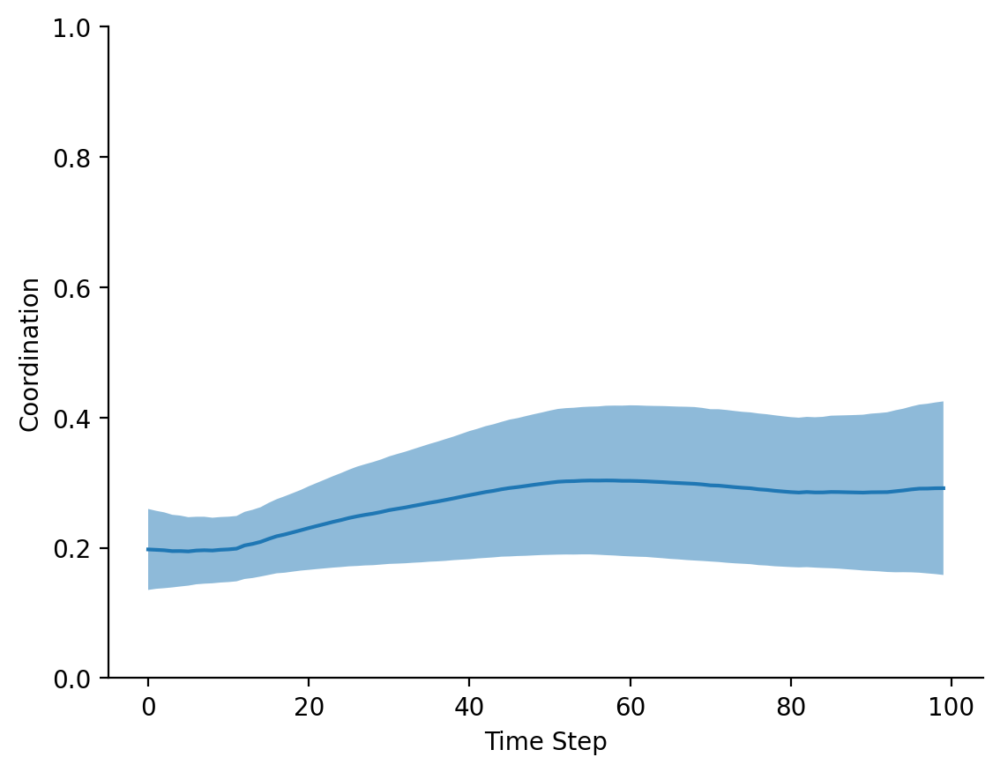

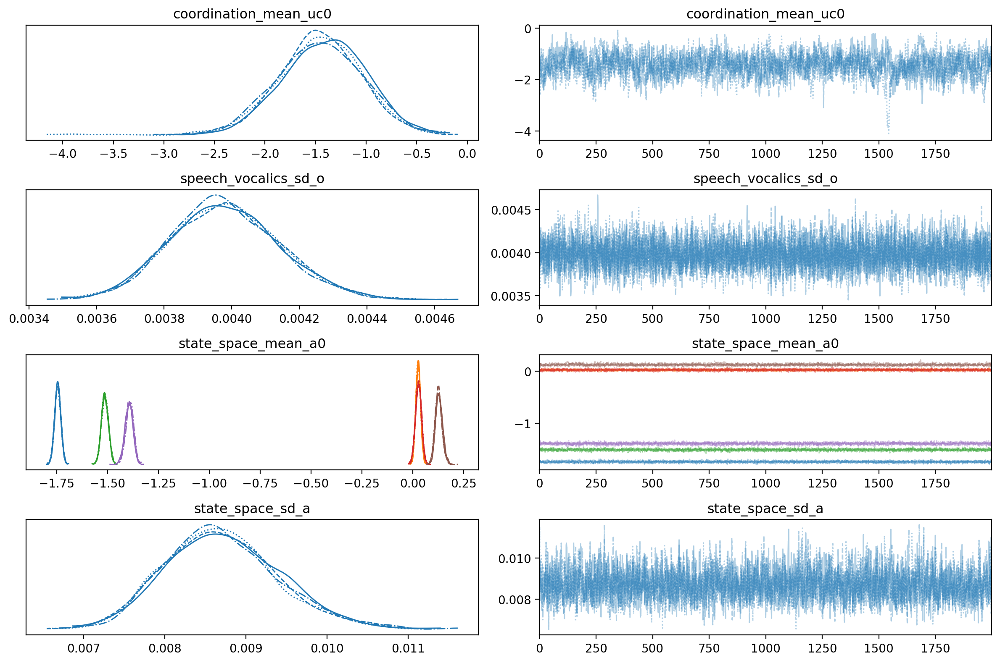

In [46]:
model = VocalicModel(deepcopy(template_bundle_b))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_b3 = train(model)

#### State space estimation

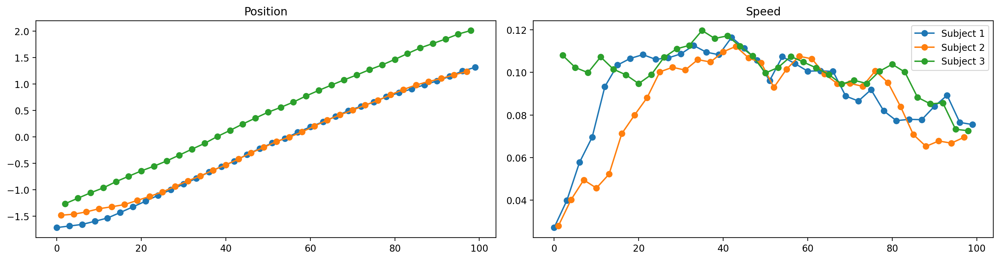

In [47]:
data_cp = deepcopy(data_b)
data_cp.component_group_samples["state_space"].values[0] = idata_b3.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

## c. Single peak coordination small noise (0.01)

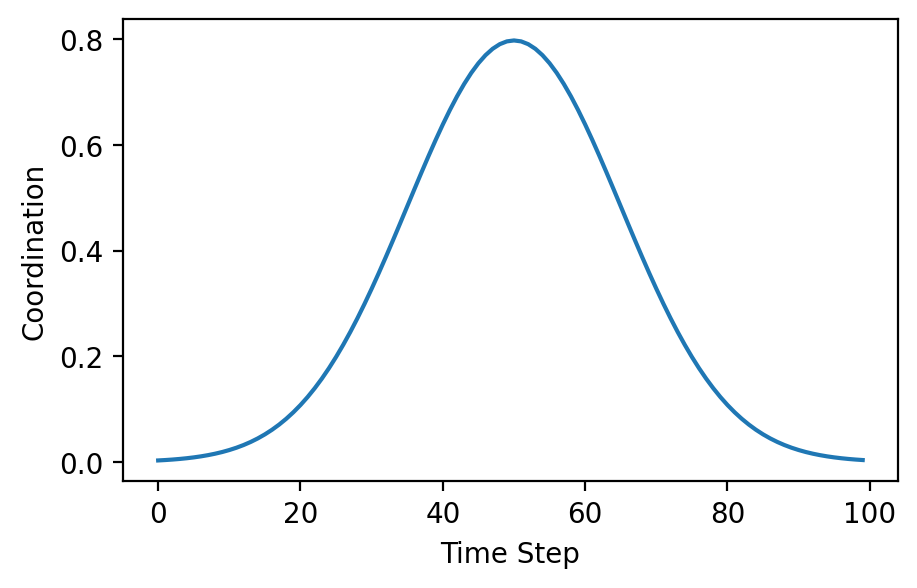

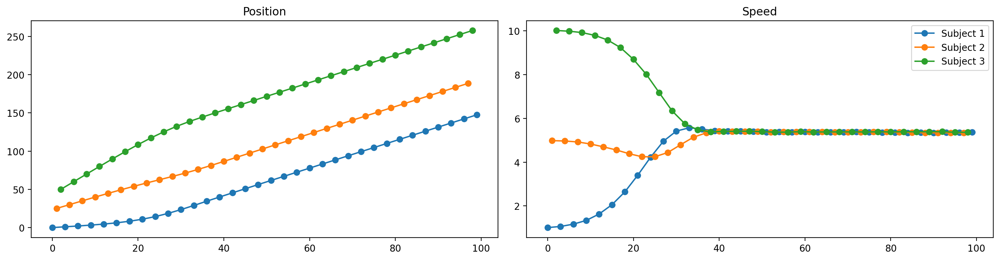

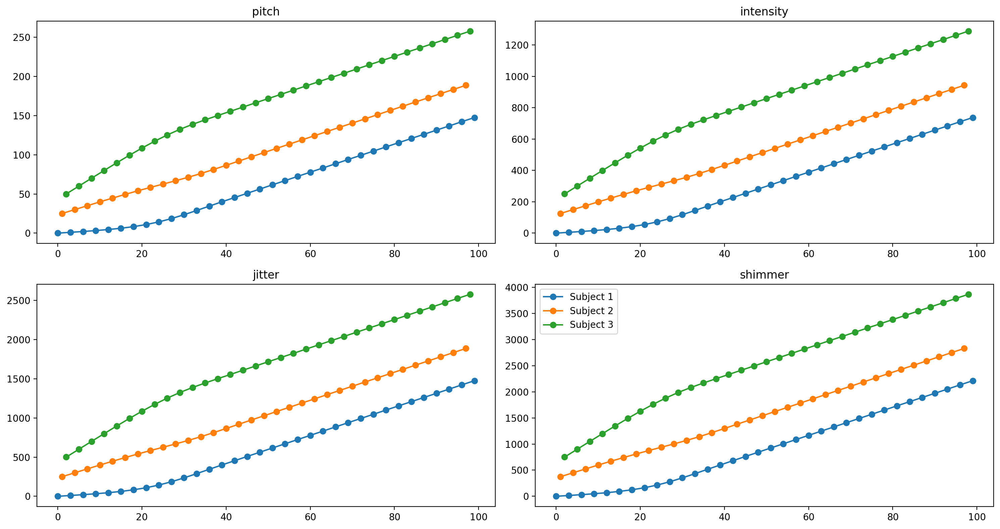

In [62]:
coordination = 30 * norm(loc=50, scale=15).pdf(np.arange(100))
template_bundle_c = configure_bundle(
    num_time_steps=100,
    coordination=coordination,
    noise=0.01
)

model = VocalicModel(deepcopy(template_bundle_c))
data_c = model.draw_samples()
update_config_bundle_from_samples(template_bundle_c, data_c)

fig = plt.figure(figsize=(5,3))	
plt.plot(np.arange(100), coordination)
plt.xlabel("Time Step")
plt.ylabel("Coordination")
plot_state_space(data_c)
plot_observations(data_c)

### c1. No given parameters

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 326 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.001292  0.000000
1  unbounded_coordination   1.004472  0.003730
2     state_space_mean_a0   1.000695  0.000518
3             state_space   1.000549  0.000533
4      coordination_sd_uc   1.003003  0.000000
5        state_space_sd_a   1.003579  0.000000
6    speech_vocalics_sd_o   1.000846  0.000000
7            coordination   1.004468  0.003734


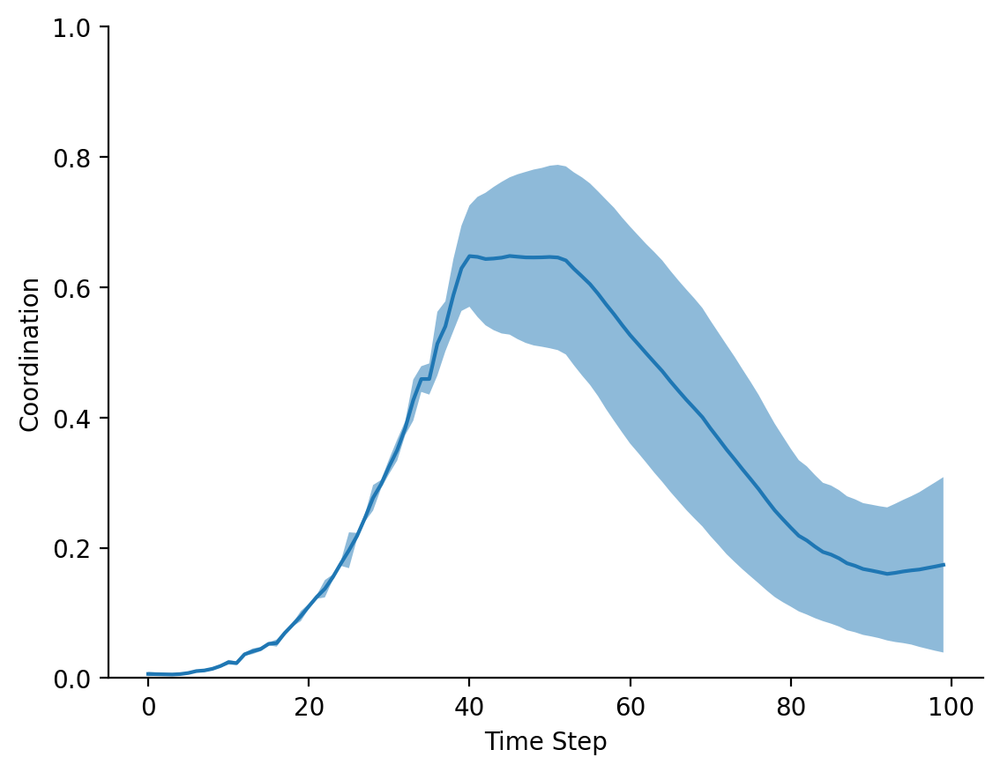

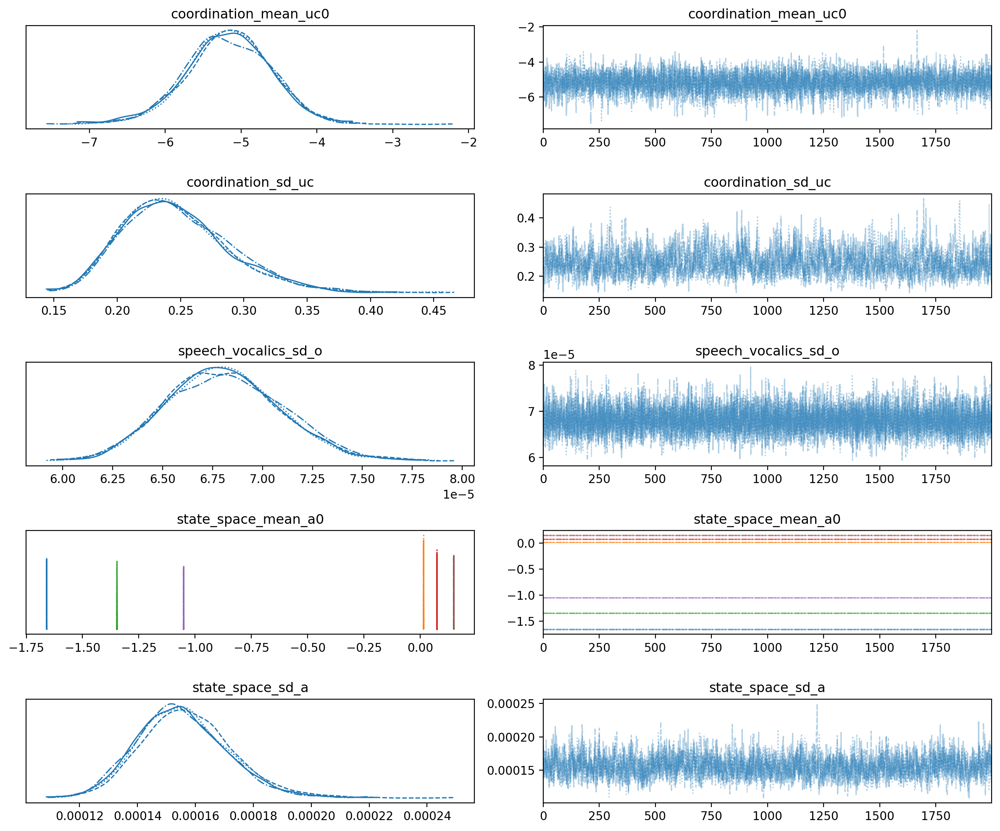

In [63]:
model = VocalicModel(deepcopy(template_bundle_c))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_c1 = train(model)

#### State space estimation

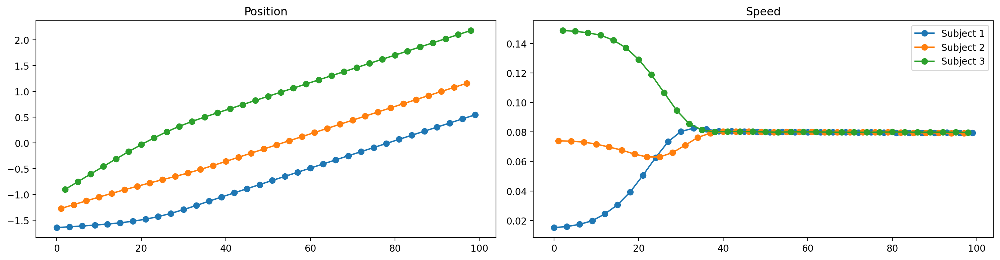

In [64]:
data_cp = deepcopy(data_c)
data_cp.component_group_samples["state_space"].values[0] = idata_c1.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

### c2. Fixed sd_uc = 0.1

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 277 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.000917  0.000000
1  unbounded_coordination   1.015611  0.014993
2     state_space_mean_a0   1.000412  0.000165
3             state_space   1.000600  0.000737
4        state_space_sd_a   1.001637  0.000000
5    speech_vocalics_sd_o   1.000412  0.000000
6            coordination   1.015609  0.014995


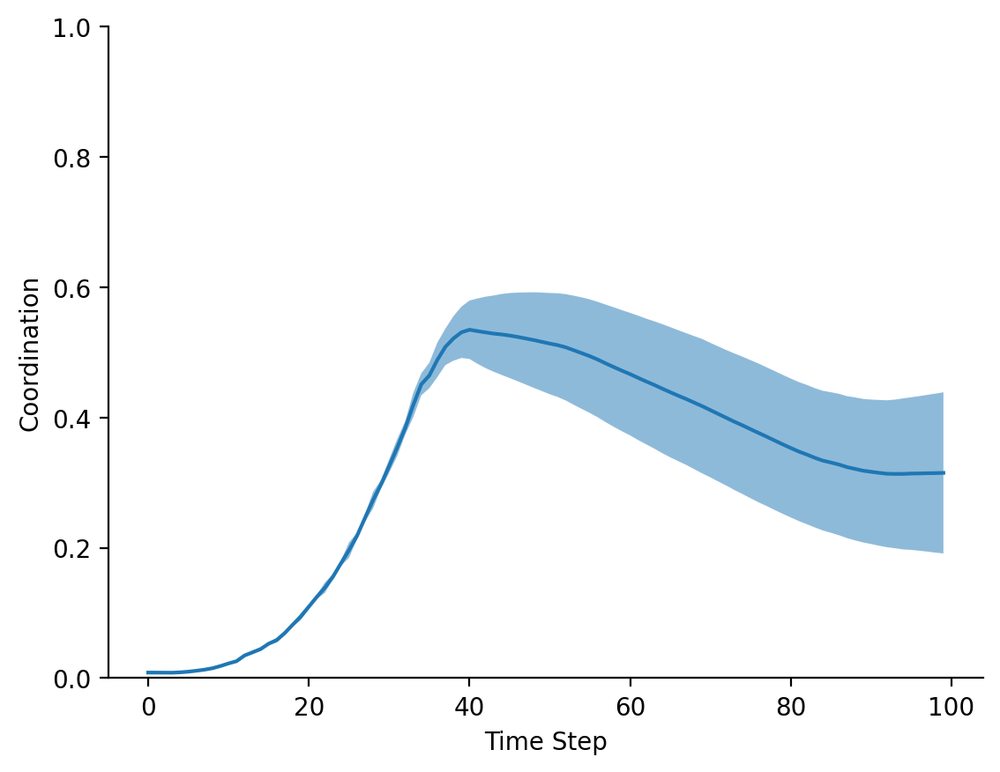

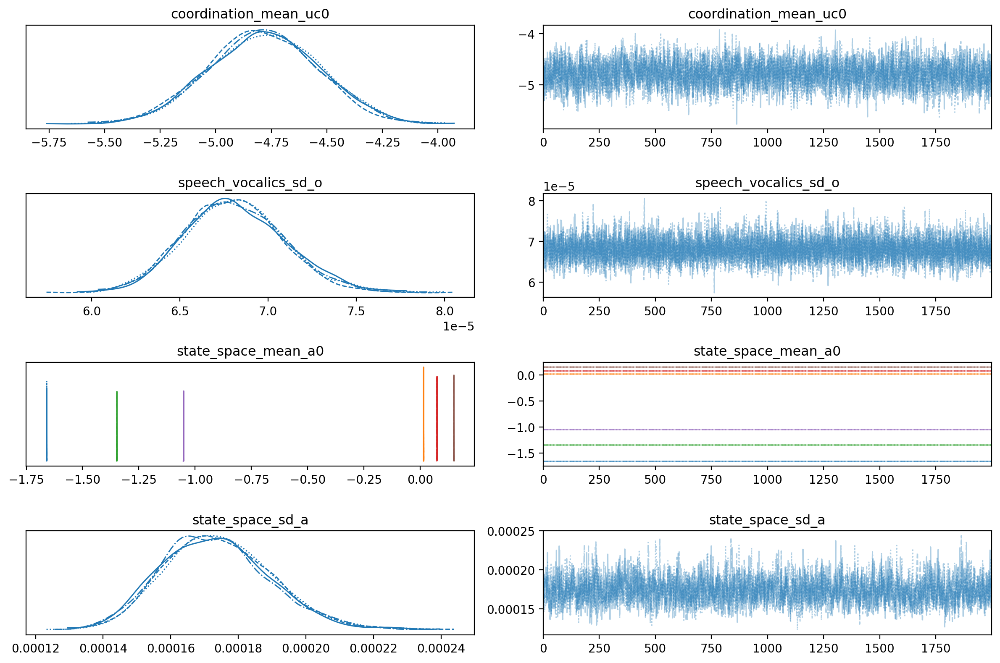

In [65]:
model = VocalicModel(deepcopy(template_bundle_c))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_c2 = train(model)

#### State space estimation

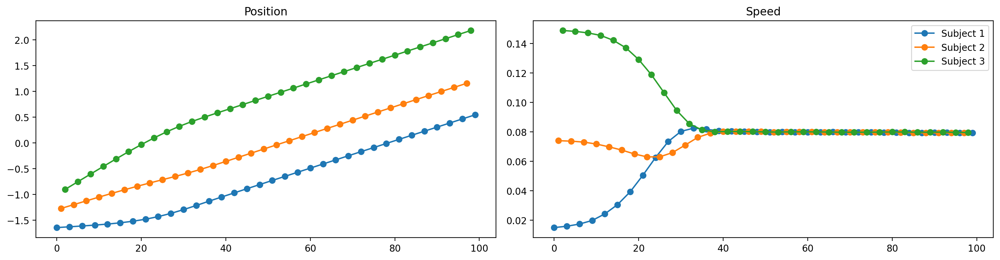

In [71]:
data_cp = deepcopy(data_c)
data_cp.component_group_samples["state_space"].values[0] = idata_c2.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

## d. Single peak coordination large noise (1)

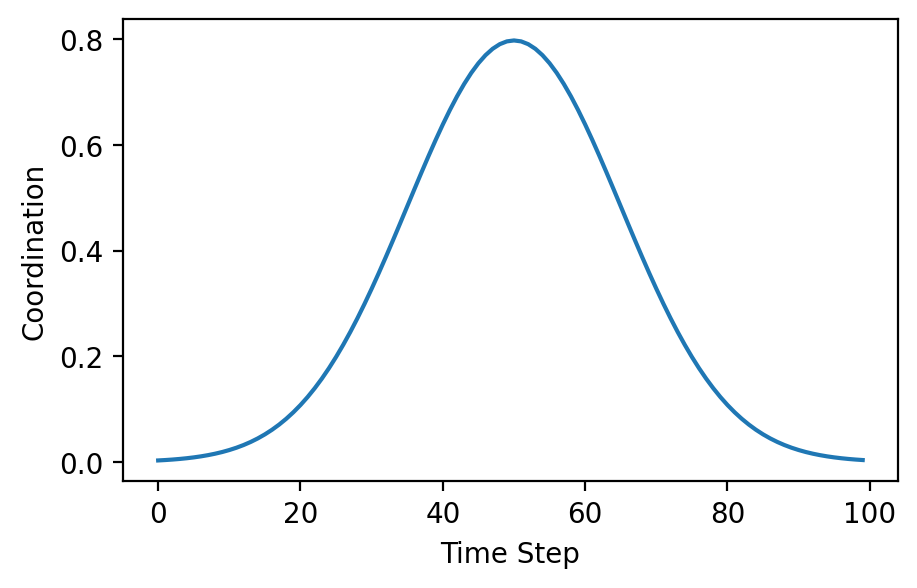

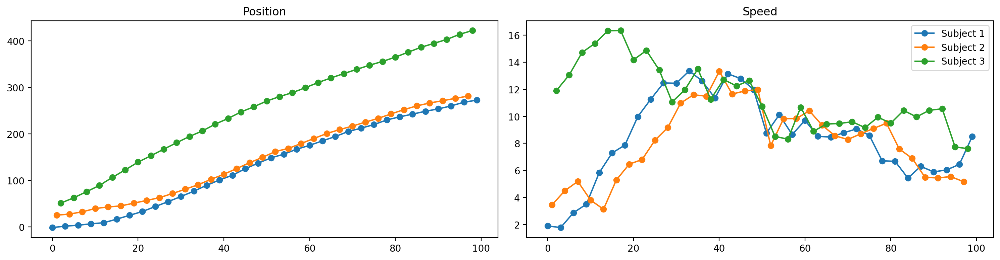

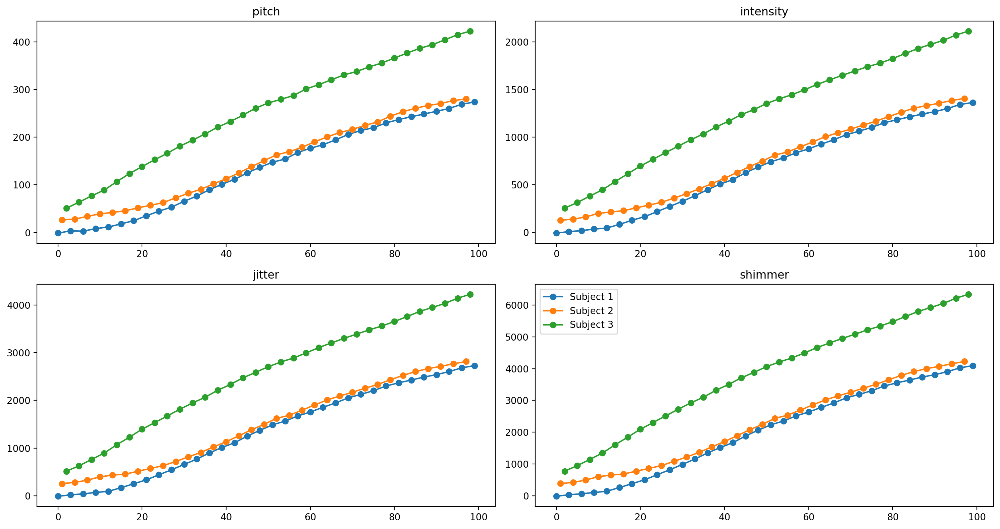

In [67]:
coordination = 30 * norm(loc=50, scale=15).pdf(np.arange(100))
template_bundle_d = configure_bundle(
    num_time_steps=100,
    coordination=coordination,
    noise=1
)

model = VocalicModel(deepcopy(template_bundle_d))
data_d = model.draw_samples()
update_config_bundle_from_samples(template_bundle_d, data_d)

fig = plt.figure(figsize=(5,3))	
plt.plot(np.arange(100), coordination)
plt.xlabel("Time Step")
plt.ylabel("Coordination")
plot_state_space(data_d)
plot_observations(data_d)

### d1. No given parameters

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 235 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.041566  0.000000
1  unbounded_coordination   1.051098  0.016371
2     state_space_mean_a0   1.008549  0.005574
3             state_space   1.000772  0.000834
4      coordination_sd_uc   1.213723  0.000000
5        state_space_sd_a   1.005422  0.000000
6    speech_vocalics_sd_o   1.000854  0.000000
7            coordination   1.043219  0.019509


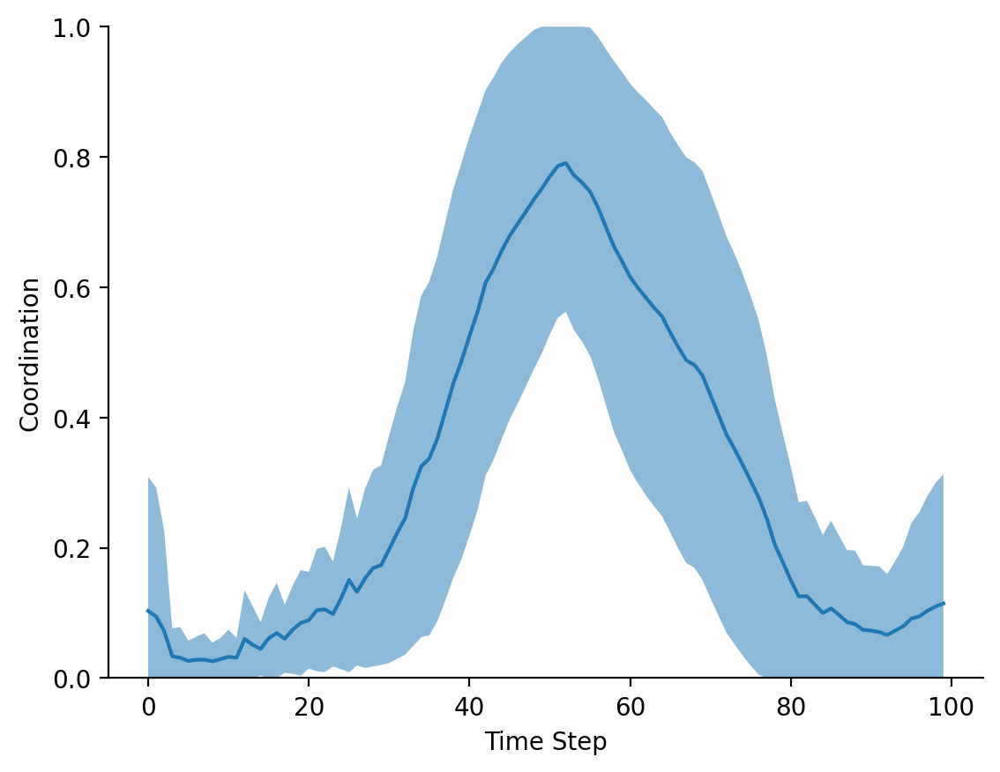

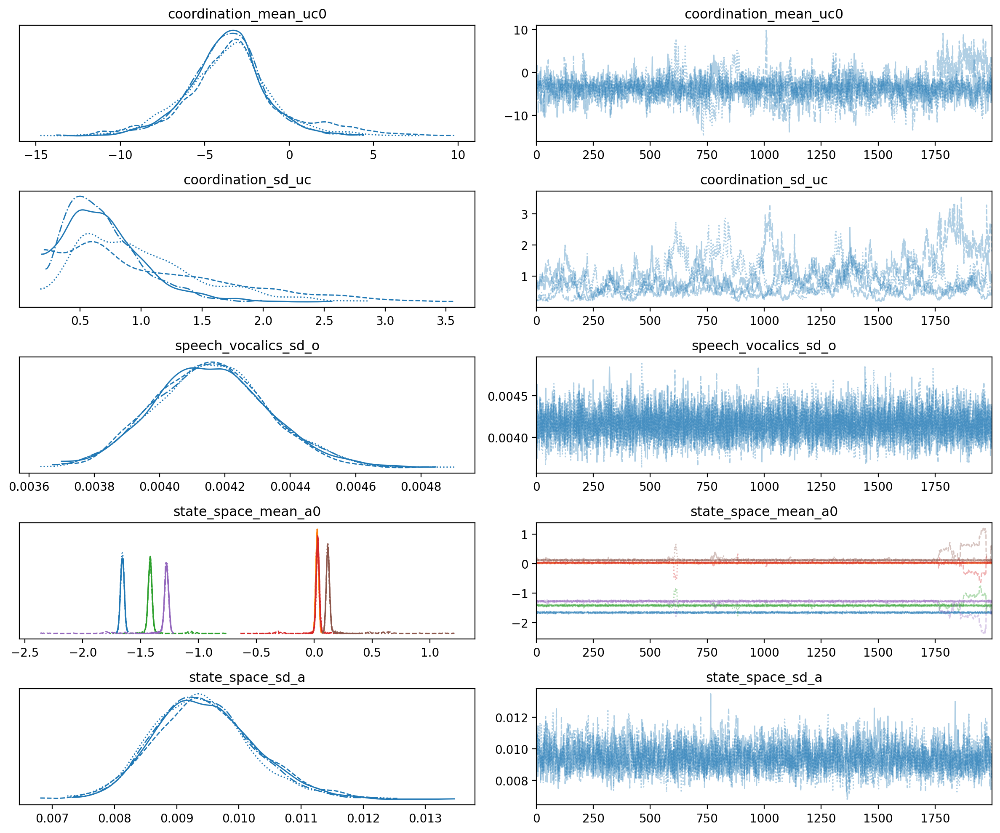

In [68]:
model = VocalicModel(deepcopy(template_bundle_d))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_d1 = train(model)

#### State space estimation

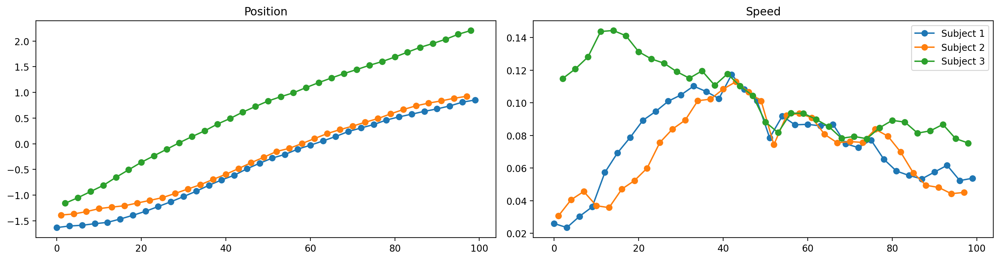

In [69]:
data_cp = deepcopy(data_d)
data_cp.component_group_samples["state_space"].values[0] = idata_d1.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

### d2. Fixed sd_uc = 0.1

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 334 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.019639  0.000000
1  unbounded_coordination   1.048905  0.011559
2     state_space_mean_a0   1.000540  0.000316
3             state_space   1.000633  0.000702
4        state_space_sd_a   1.001800  0.000000
5    speech_vocalics_sd_o   1.000458  0.000000
6            coordination   1.048905  0.011559


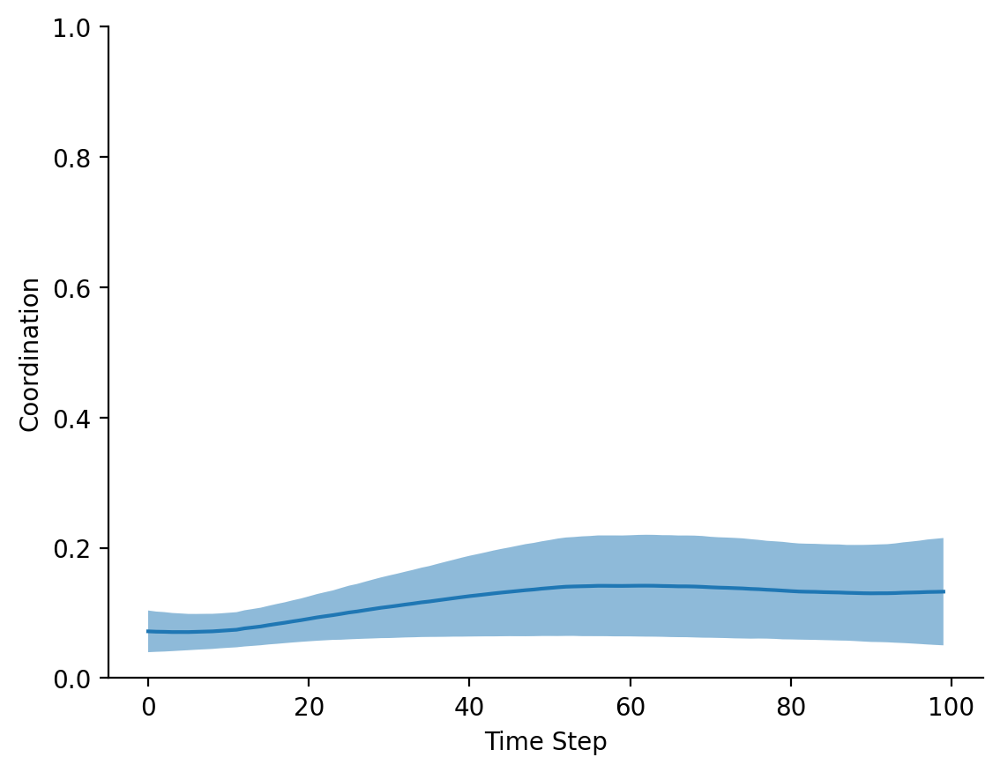

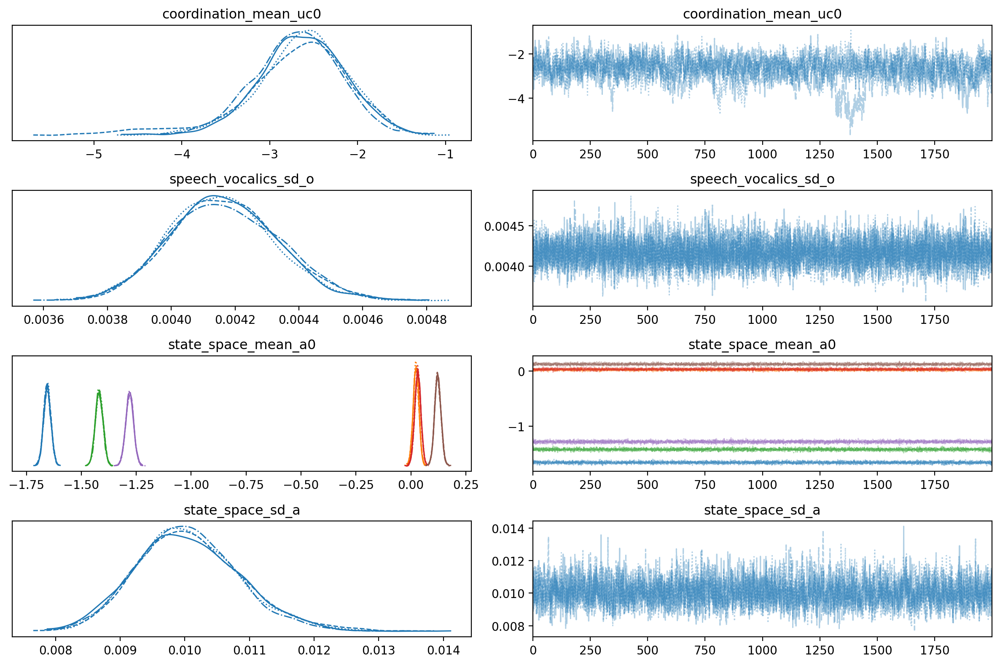

In [70]:
model = VocalicModel(deepcopy(template_bundle_d))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_d2 = train(model)

#### State space estimation

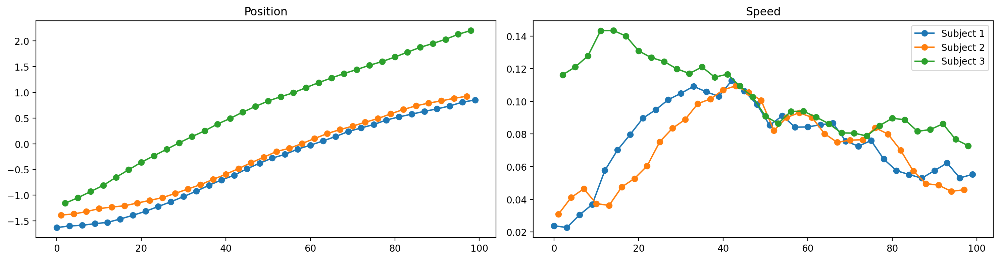

In [72]:
data_cp = deepcopy(data_d)
data_cp.component_group_samples["state_space"].values[0] = idata_d2.average_posterior_samples("state_space", return_std=False)
plot_state_space(data_cp)

# Data density

How the uncertainty increases when we don't have samples at every time step.

## e. 80%

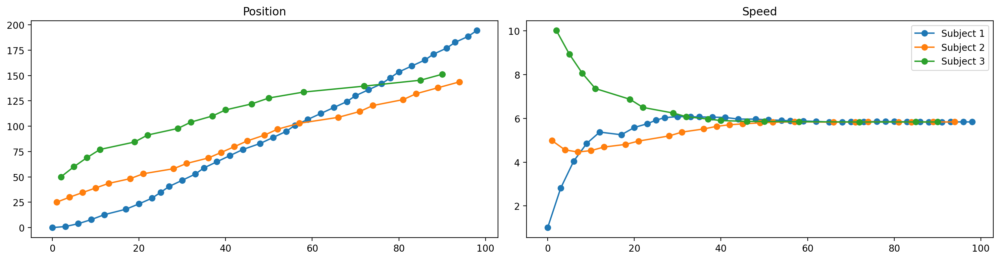

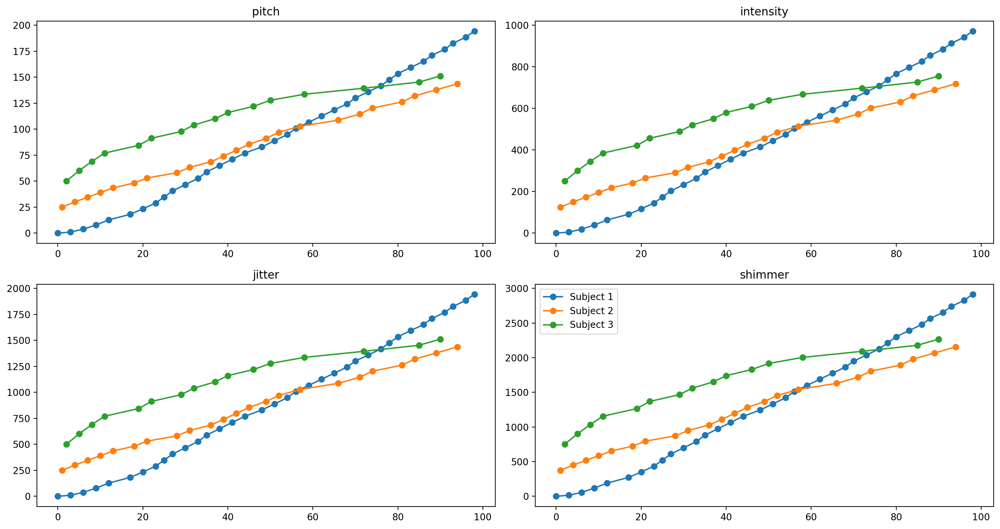

In [125]:
template_bundle_e = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

template_bundle_e.sampling_time_scale_density = 0.8
model = VocalicModel(deepcopy(template_bundle_e))
data_e = model.draw_samples()
update_config_bundle_from_samples(template_bundle_e, data_e)

plot_state_space(data_e)
plot_observations(data_e)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 574 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.126299  0.000000
1  unbounded_coordination   1.116355  0.039483
2     state_space_mean_a0   1.021488  0.014208
3             state_space   1.001419  0.002882
4      coordination_sd_uc   1.357383  0.000000
5        state_space_sd_a   1.019422  0.000000
6    speech_vocalics_sd_o   1.000183  0.000000
7            coordination   1.117007  0.039793


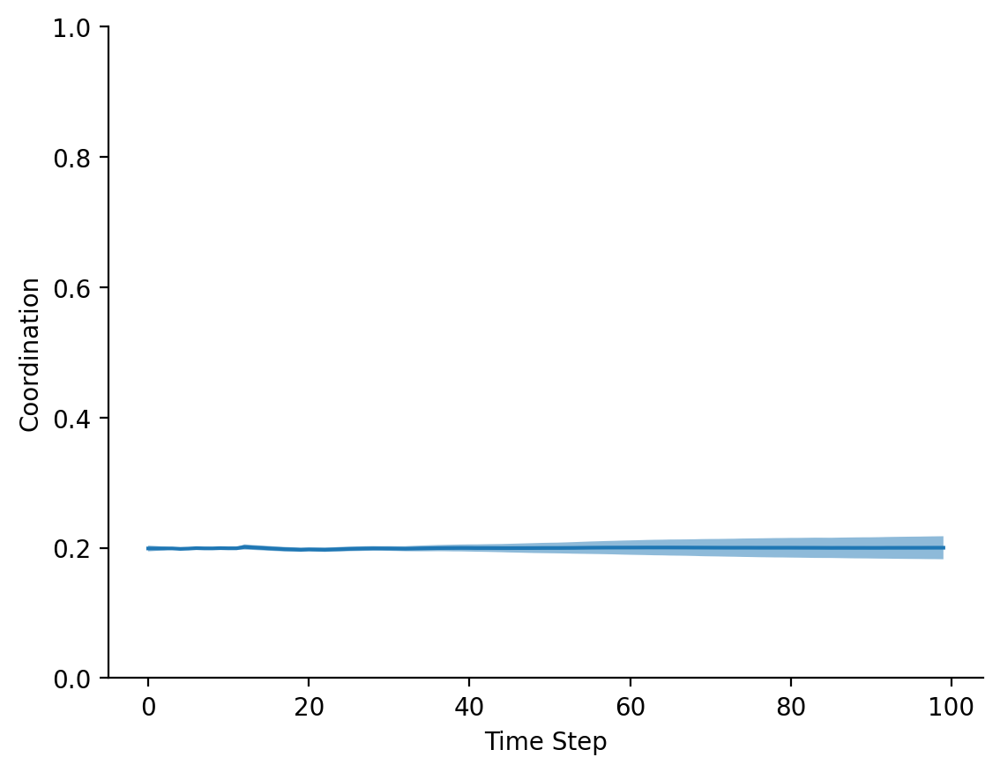

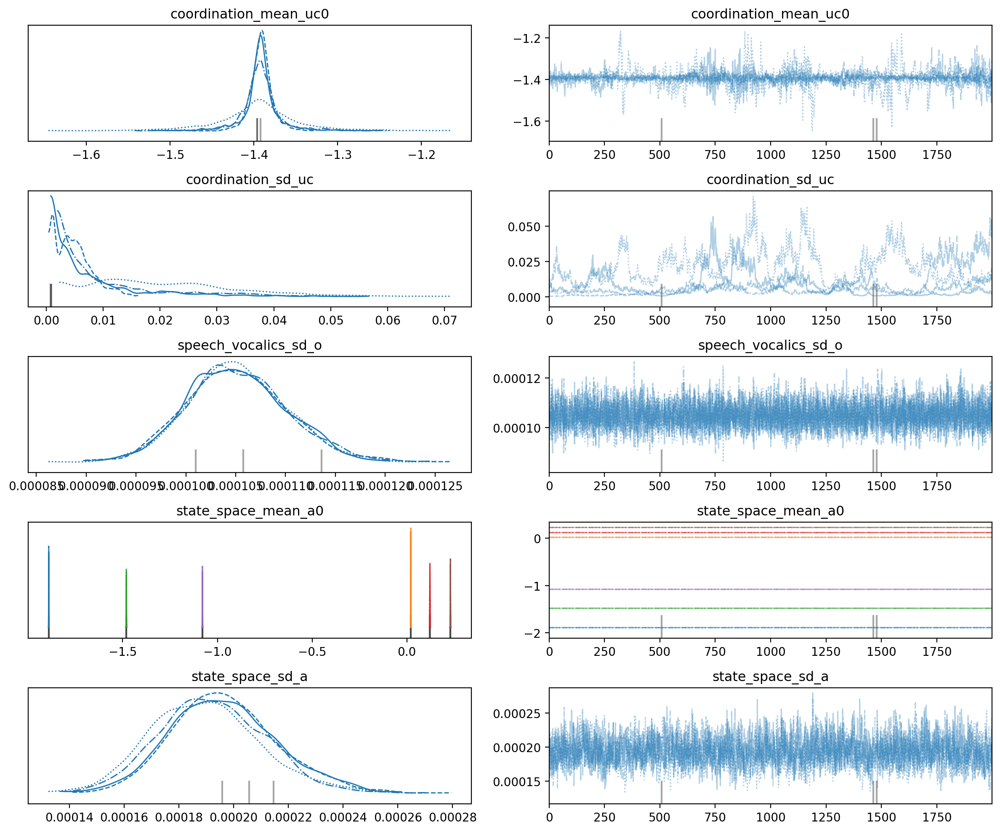

In [74]:
model = VocalicModel(deepcopy(template_bundle_e))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_e1 = train(model)

## f. 50%

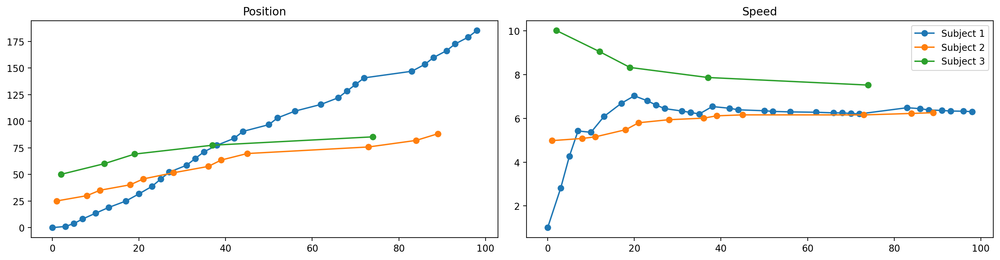

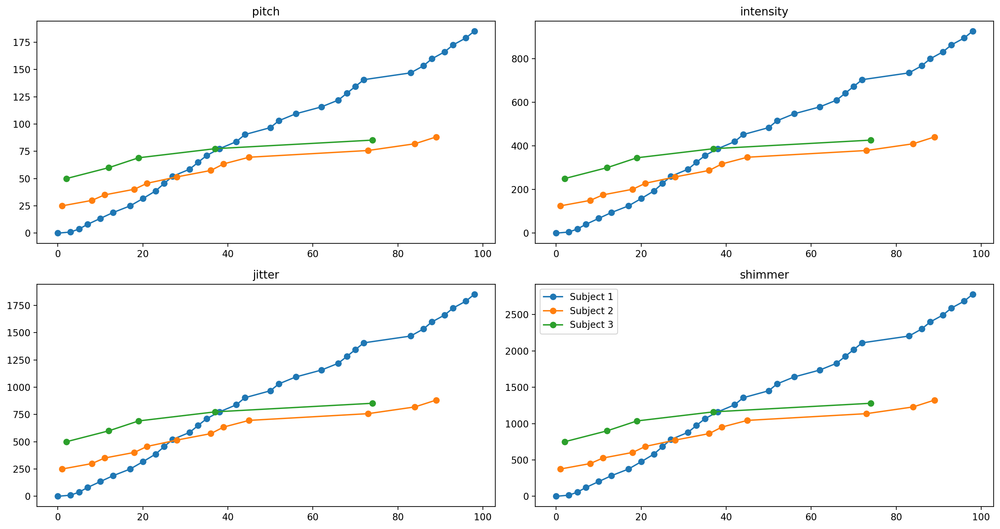

In [126]:
template_bundle_f = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

template_bundle_f.sampling_time_scale_density = 0.5
model = VocalicModel(deepcopy(template_bundle_f))
data_f = model.draw_samples()
update_config_bundle_from_samples(template_bundle_f, data_f)

plot_state_space(data_f)
plot_observations(data_f)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 486 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.022418  0.000000
1  unbounded_coordination   1.013562  0.007453
2     state_space_mean_a0   1.005385  0.004003
3             state_space   1.006320  0.005571
4      coordination_sd_uc   1.056095  0.000000
5        state_space_sd_a   1.008128  0.000000
6    speech_vocalics_sd_o   1.005962  0.000000
7            coordination   1.013512  0.007384


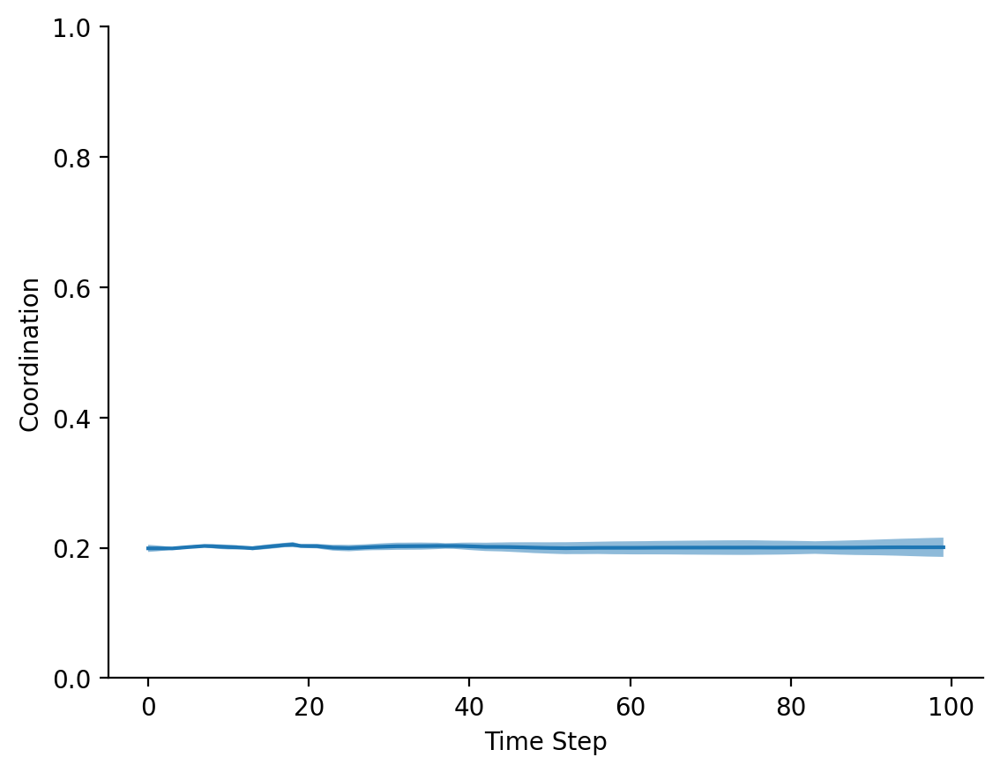

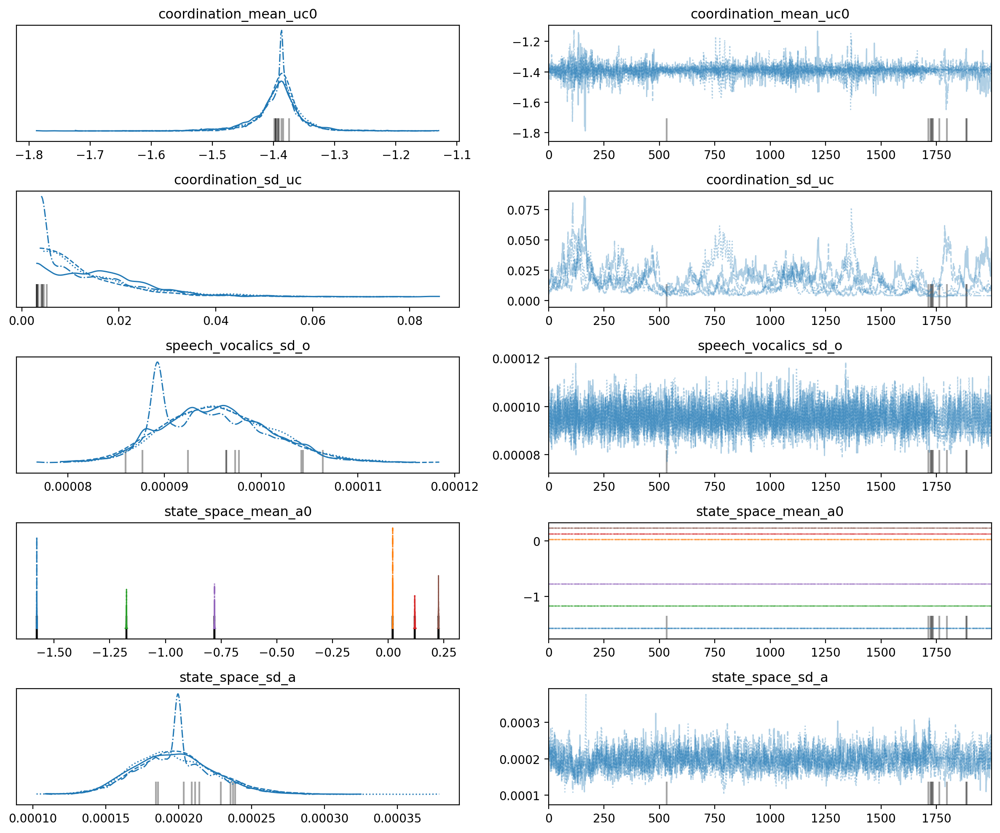

In [76]:
model = VocalicModel(deepcopy(template_bundle_f))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_f1 = train(model)

## g. 20%

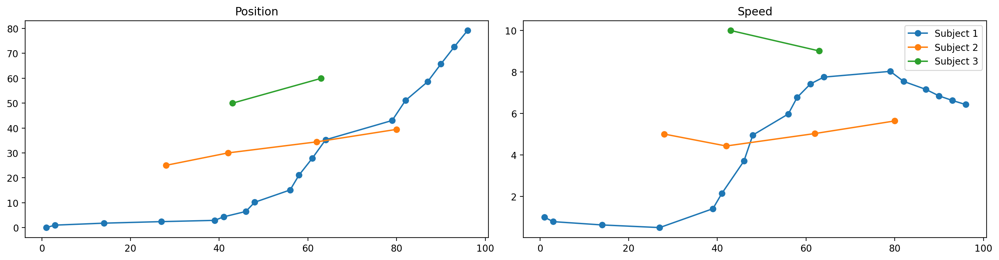

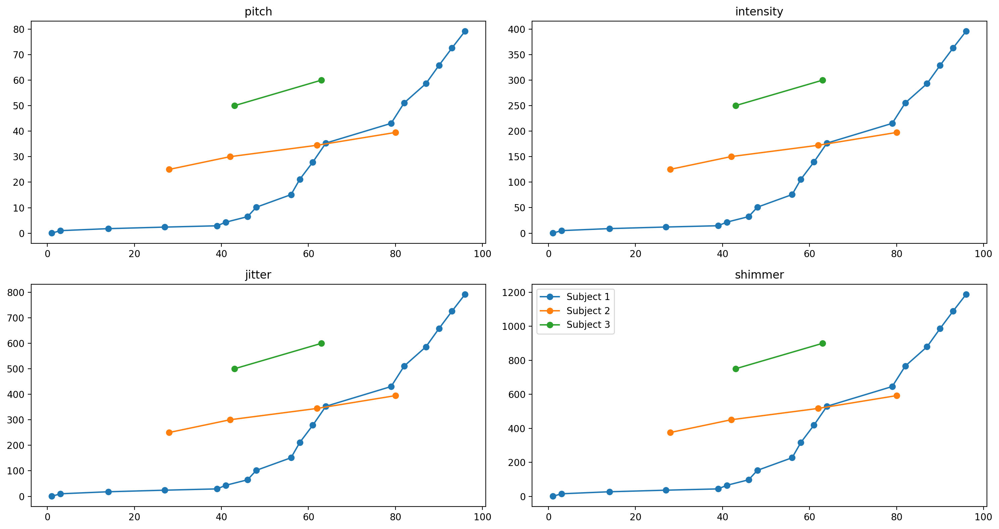

In [127]:
template_bundle_g = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

template_bundle_g.sampling_time_scale_density = 0.2
model = VocalicModel(deepcopy(template_bundle_g))
data_g = model.draw_samples(seed=5)
update_config_bundle_from_samples(template_bundle_g, data_g)

plot_state_space(data_g)
plot_observations(data_g)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 737 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.052980  0.000000
1  unbounded_coordination   1.036555  0.010866
2     state_space_mean_a0   1.007305  0.006292
3             state_space   1.001437  0.001392
4      coordination_sd_uc   1.147558  0.000000
5        state_space_sd_a   1.007206  0.000000
6    speech_vocalics_sd_o   1.000533  0.000000
7            coordination   1.036349  0.010646


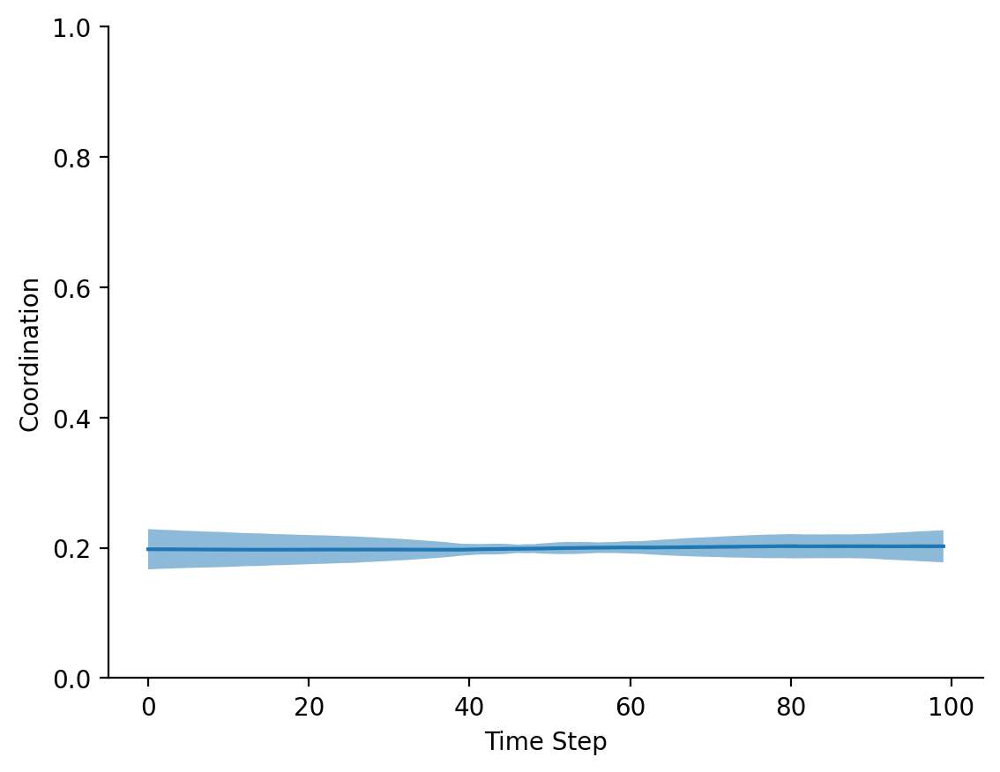

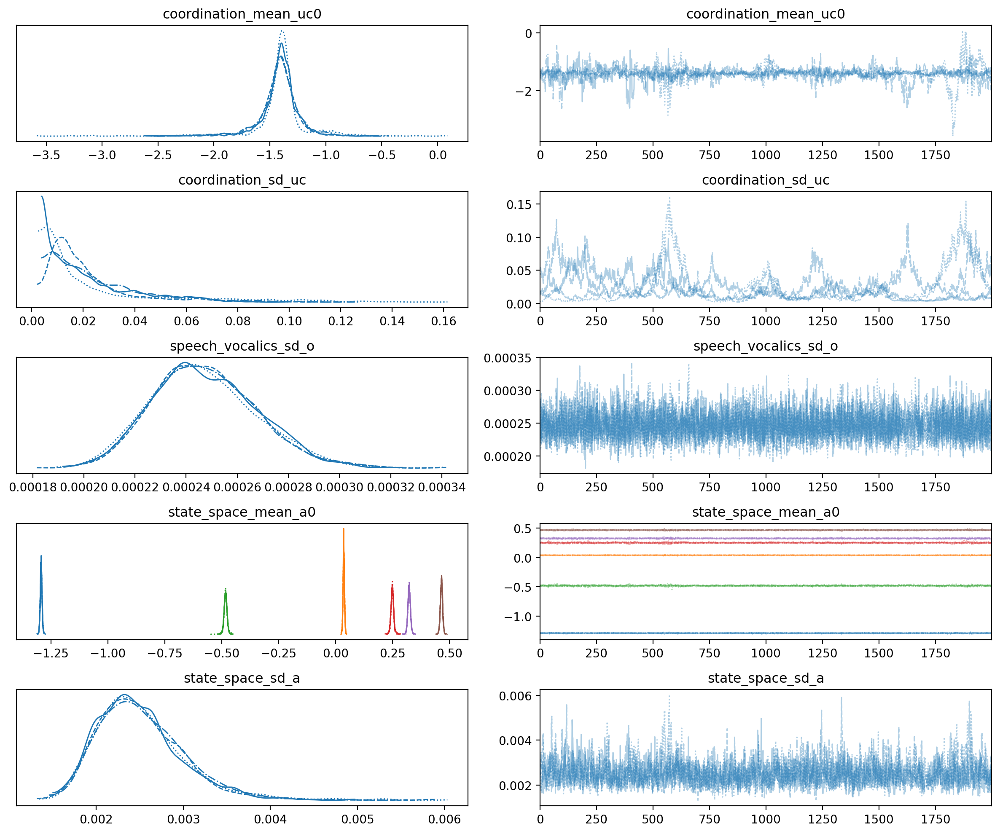

In [101]:
model = VocalicModel(deepcopy(template_bundle_g))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_g1 = train(model)

## h. 20% single peak coordination

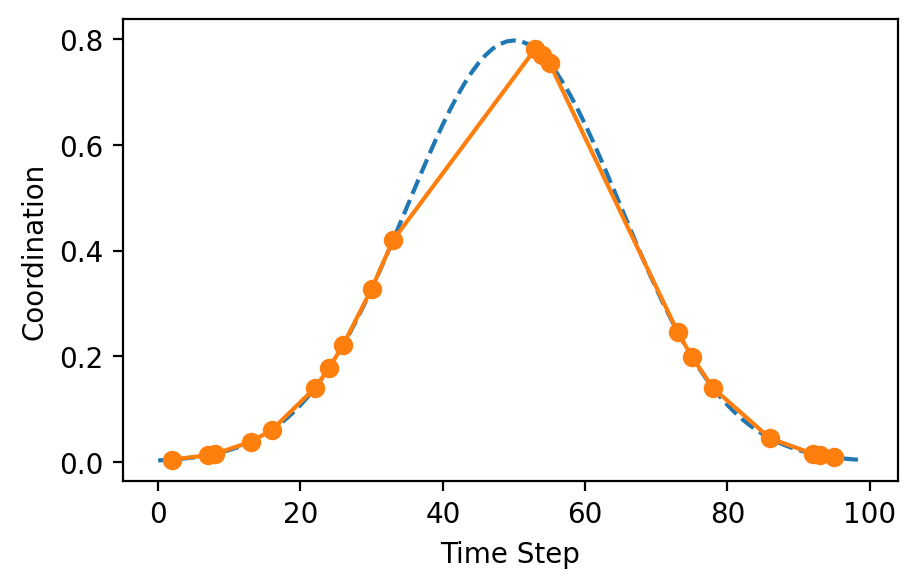

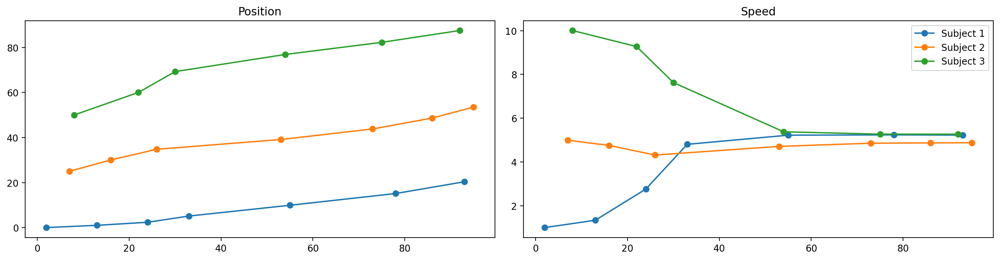

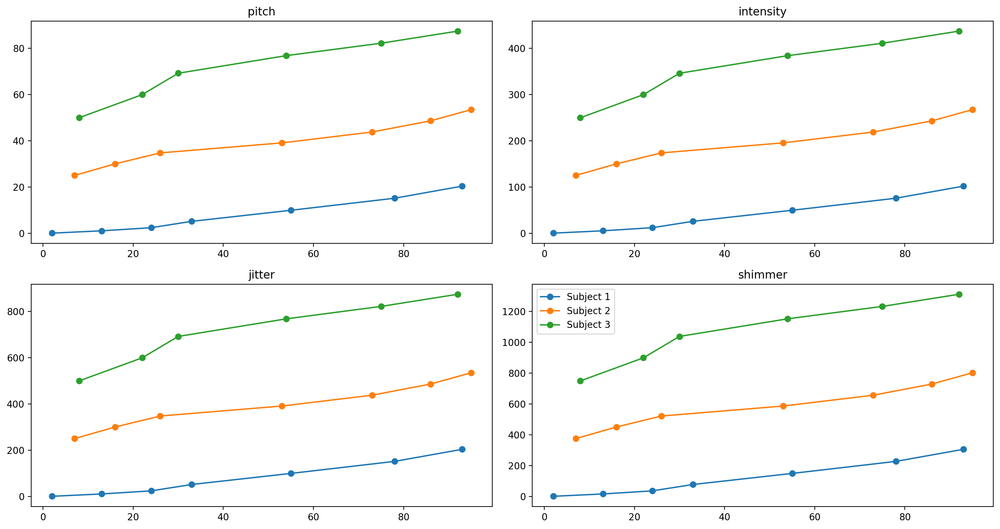

In [147]:
np.random.seed(0)
time_steps_to_keep = np.random.choice(np.arange(100), size=20, replace=False)
time_steps_to_keep.sort()
coordination = 30 * norm(loc=50, scale=15).pdf(np.arange(100))

template_bundle_h = configure_bundle(
    num_time_steps=20,
    coordination=coordination[time_steps_to_keep],
    noise=0.01
)

model = VocalicModel(deepcopy(template_bundle_h))
data_h = model.draw_samples()

# Samples to keep
template_bundle_h.num_time_steps_in_coordination_scale = 100
data_h.component_group_samples["state_space"].time_steps_in_coordination_scale[0] = time_steps_to_keep
data_h.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0] = time_steps_to_keep
update_config_bundle_from_samples(template_bundle_h, data_h)

fig = plt.figure(figsize=(5,3))	
plt.plot(np.arange(100), coordination, "--")
plt.plot(time_steps_to_keep, coordination[time_steps_to_keep], marker="o")
plt.xlabel("Time Step")
plt.ylabel("Coordination")
plot_state_space(data_h)
plot_observations(data_h)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1404 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.006545  0.000000
1  unbounded_coordination   1.005765  0.002850
2     state_space_mean_a0   1.012187  0.004512
3             state_space   1.006850  0.004153
4      coordination_sd_uc   1.015637  0.000000
5        state_space_sd_a   1.019461  0.000000
6    speech_vocalics_sd_o   1.003275  0.000000
7            coordination   1.006059  0.003228


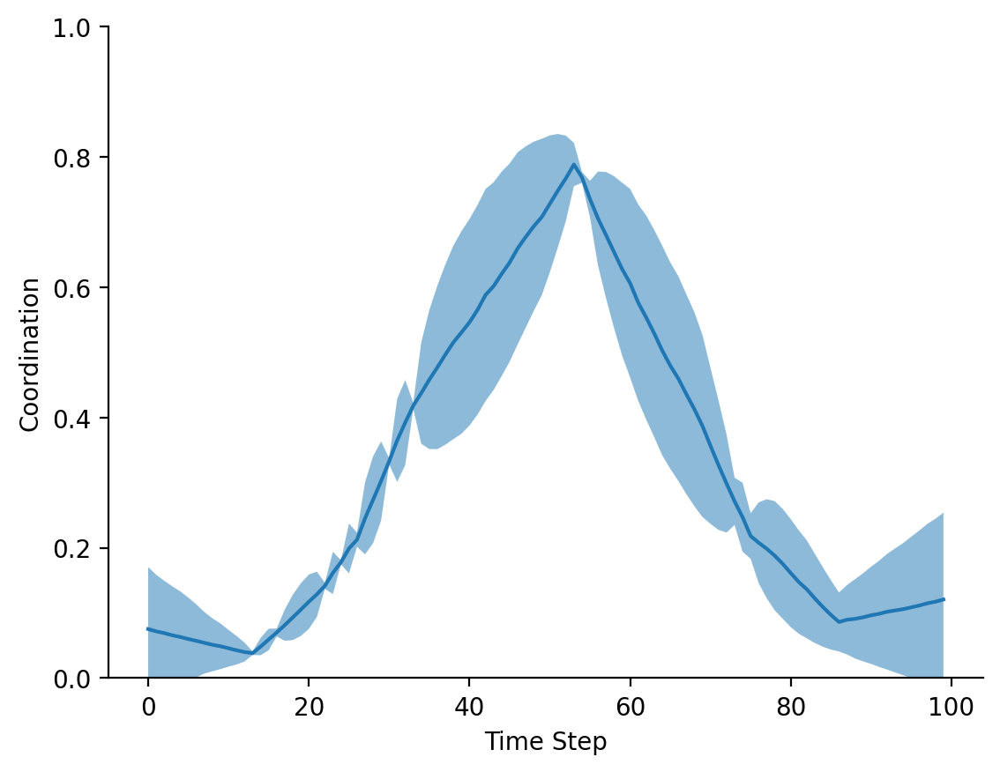

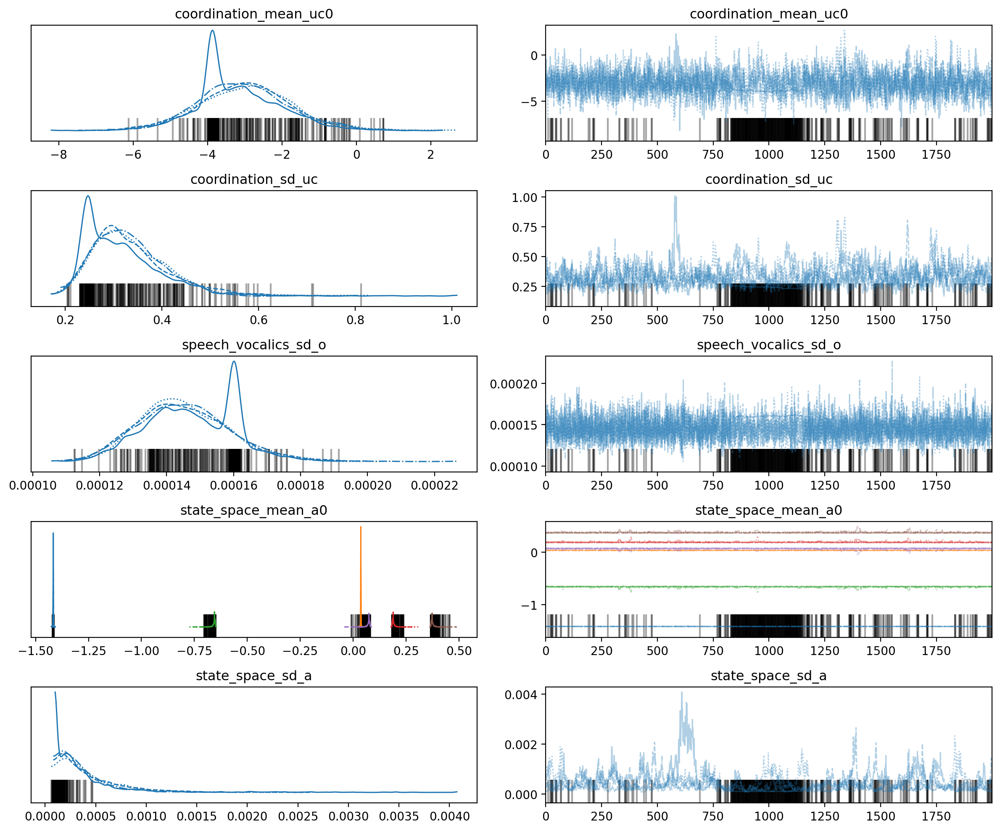

In [150]:
model = VocalicModel(deepcopy(template_bundle_h))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_h1 = train(model)

#### Longer burn-in

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 1781 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.005087  0.000000
1  unbounded_coordination   1.003423  0.002026
2     state_space_mean_a0   1.010825  0.004840
3             state_space   1.002494  0.001753
4      coordination_sd_uc   1.017555  0.000000
5        state_space_sd_a   1.012314  0.000000
6    speech_vocalics_sd_o   1.000150  0.000000
7            coordination   1.003554  0.002640


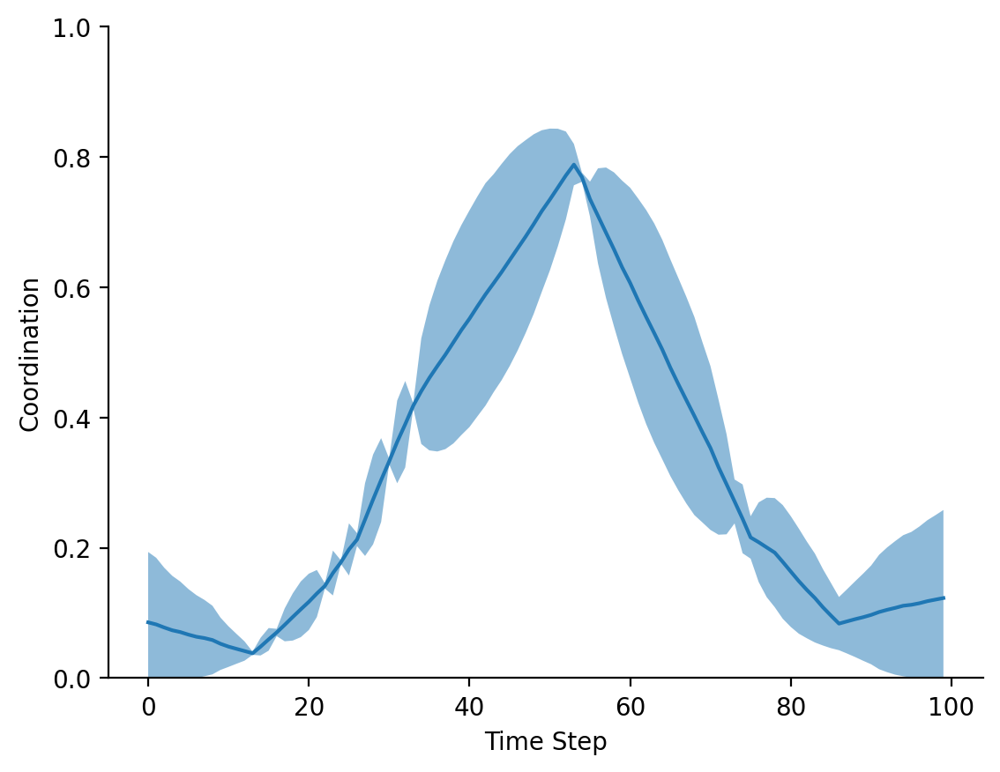

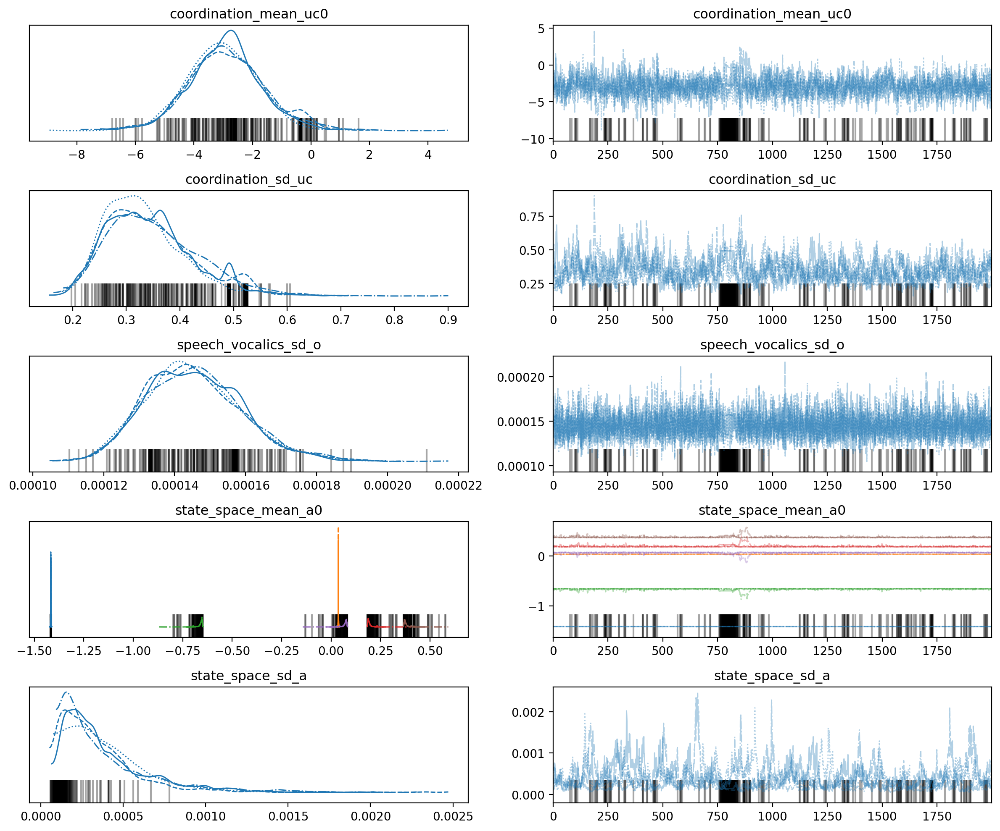

In [151]:
idata_h2 = train(model, burn_in=4000, recreate_variables=False)

1.0
Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 912 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.020687  0.000000
1  unbounded_coordination   1.035114  0.024141
2     state_space_mean_a0   1.042757  0.012998
3             state_space   1.040104  0.027298
4      coordination_sd_uc   1.040375  0.000000
5        state_space_sd_a   1.184571  0.000000
6    speech_vocalics_sd_o   1.066025  0.000000
7            coordination   1.037131  0.023662


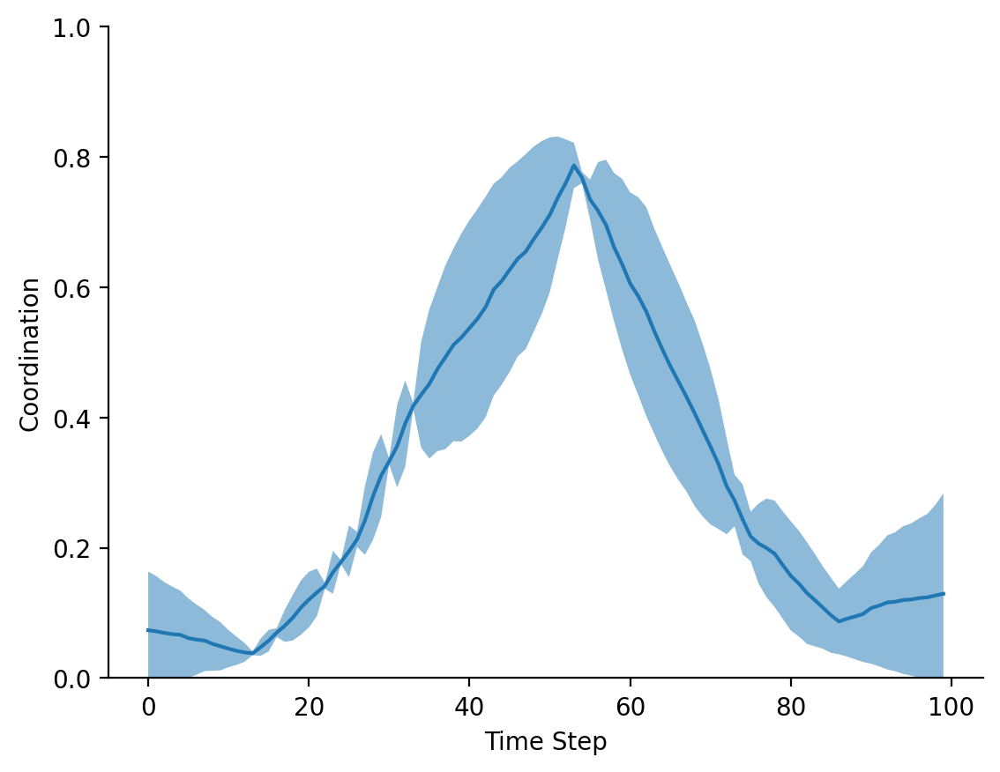

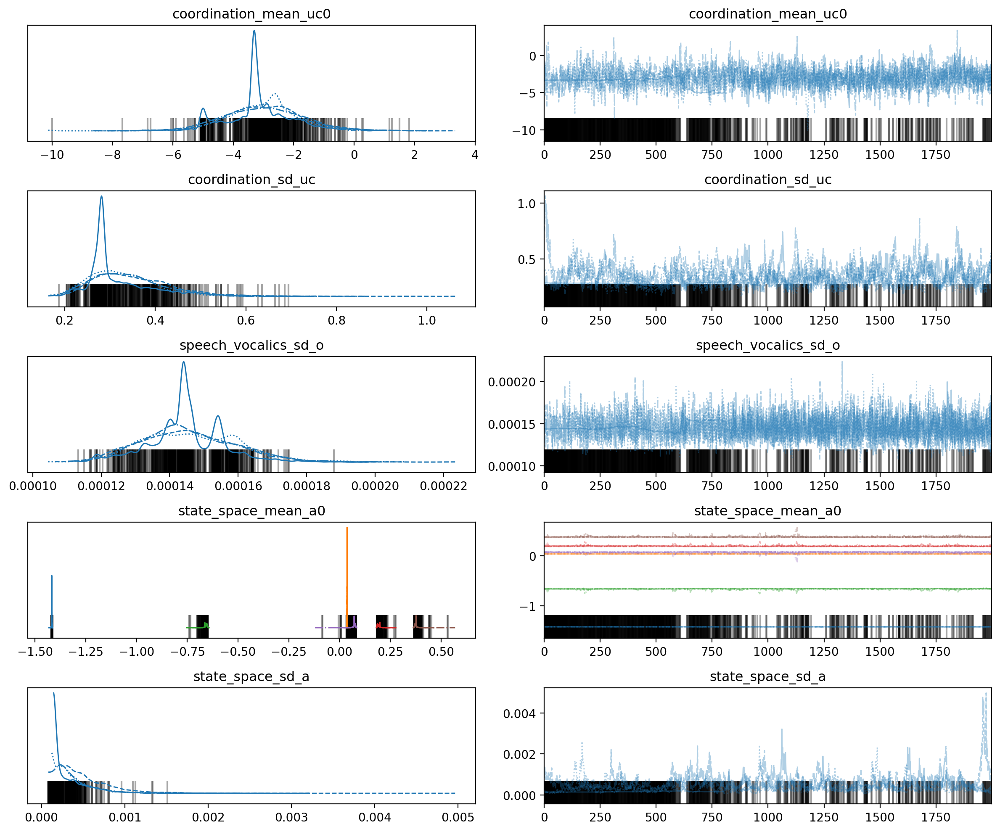

In [209]:
model = VocalicModel(deepcopy(template_bundle_h))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.sd_sd_uc = 5
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata_h3 = train(model)

# Convergence

Assess whether increasing the number of burn-in samples leads to better convergence.

## i. replicating a4 larger burn-in samples

In [135]:
model = VocalicModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

### i1. burn-in = 8000

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 8_000 tune and 2_000 draw iterations (32_000 + 8_000 draws total) took 2163 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.111529  0.000000
1  unbounded_coordination   1.142108  0.050855
2     state_space_mean_a0   1.033197  0.023799
3             state_space   1.001390  0.003722
4      coordination_sd_uc   1.253259  0.000000
5        state_space_sd_a   1.024998  0.000000
6    speech_vocalics_sd_o   1.001338  0.000000
7            coordination   1.137073  0.046656


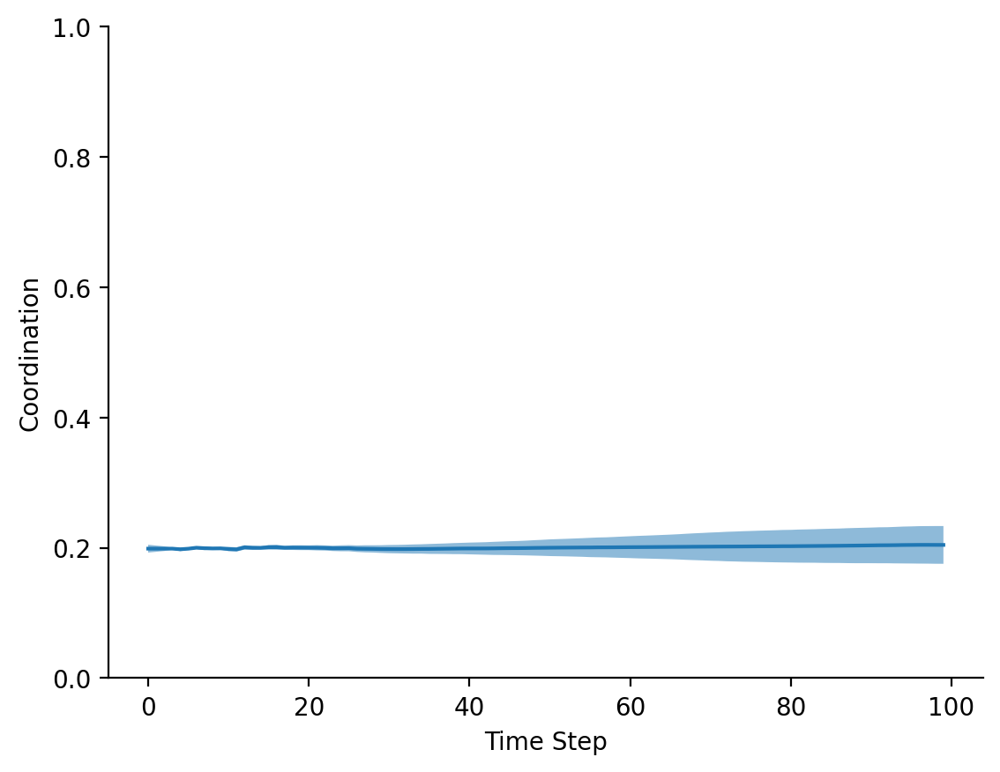

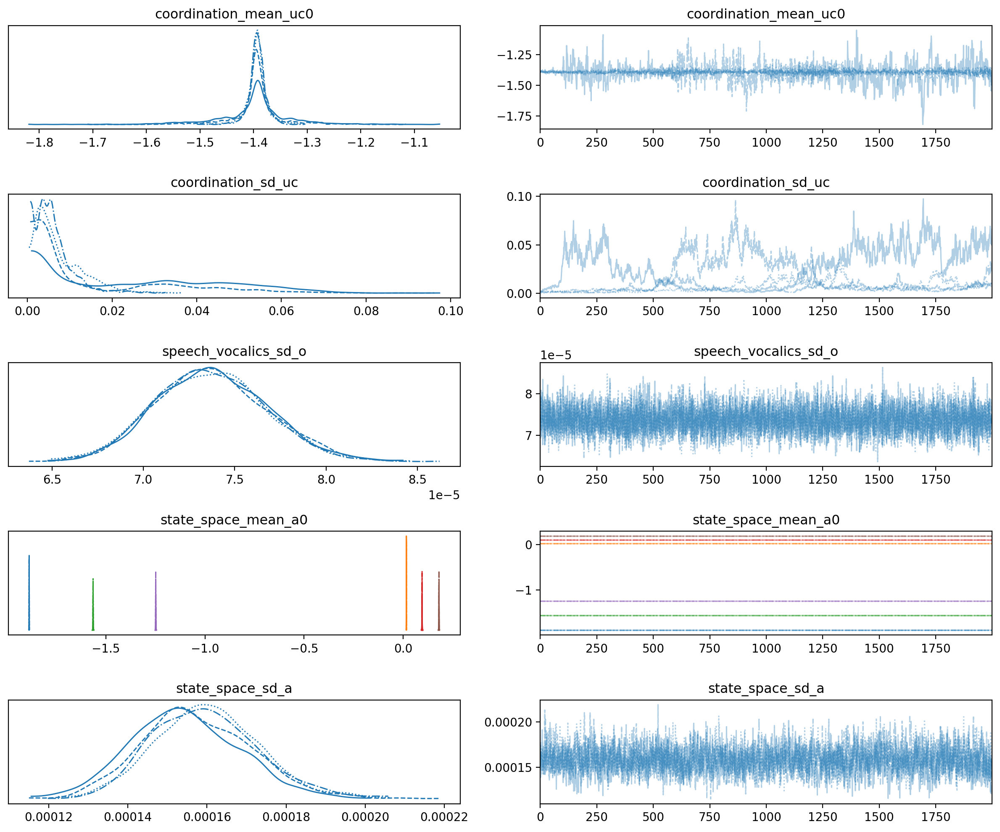

In [136]:
idata_i1 = train(model, burn_in=8000)

### i2. burn-in = 16000

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 16_000 tune and 2_000 draw iterations (64_000 + 8_000 draws total) took 2856 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.064471  0.000000
1  unbounded_coordination   1.088854  0.036807
2     state_space_mean_a0   1.011006  0.007715
3             state_space   1.000963  0.001735
4      coordination_sd_uc   1.242655  0.000000
5        state_space_sd_a   1.010306  0.000000
6    speech_vocalics_sd_o   0.999987  0.000000
7            coordination   1.087989  0.035996


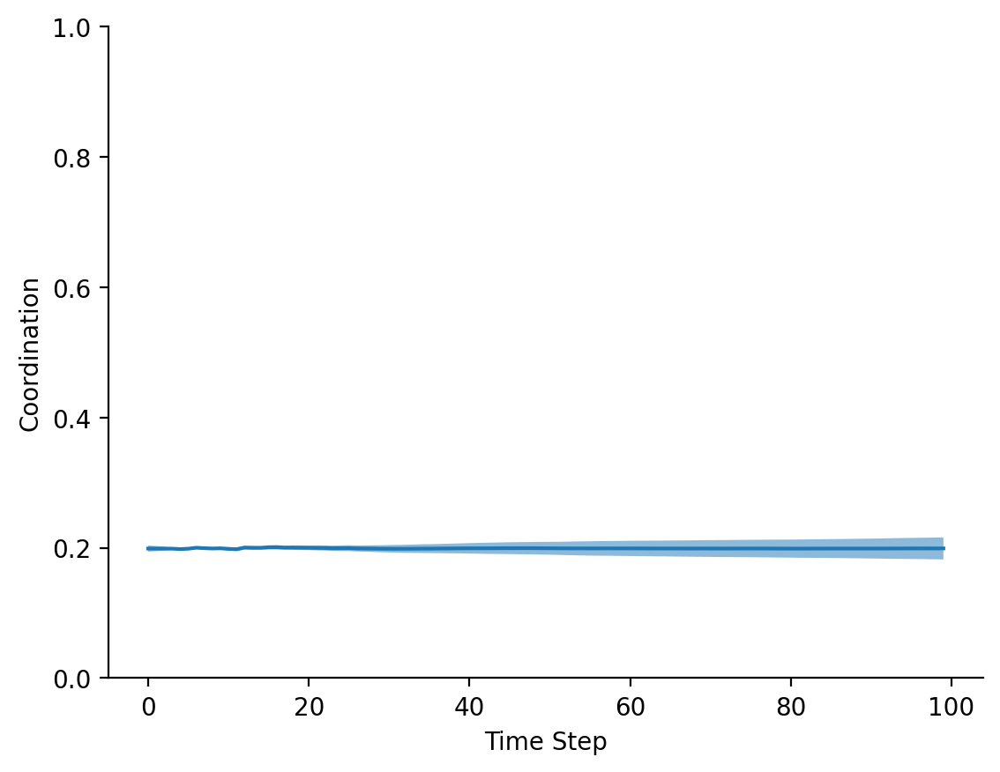

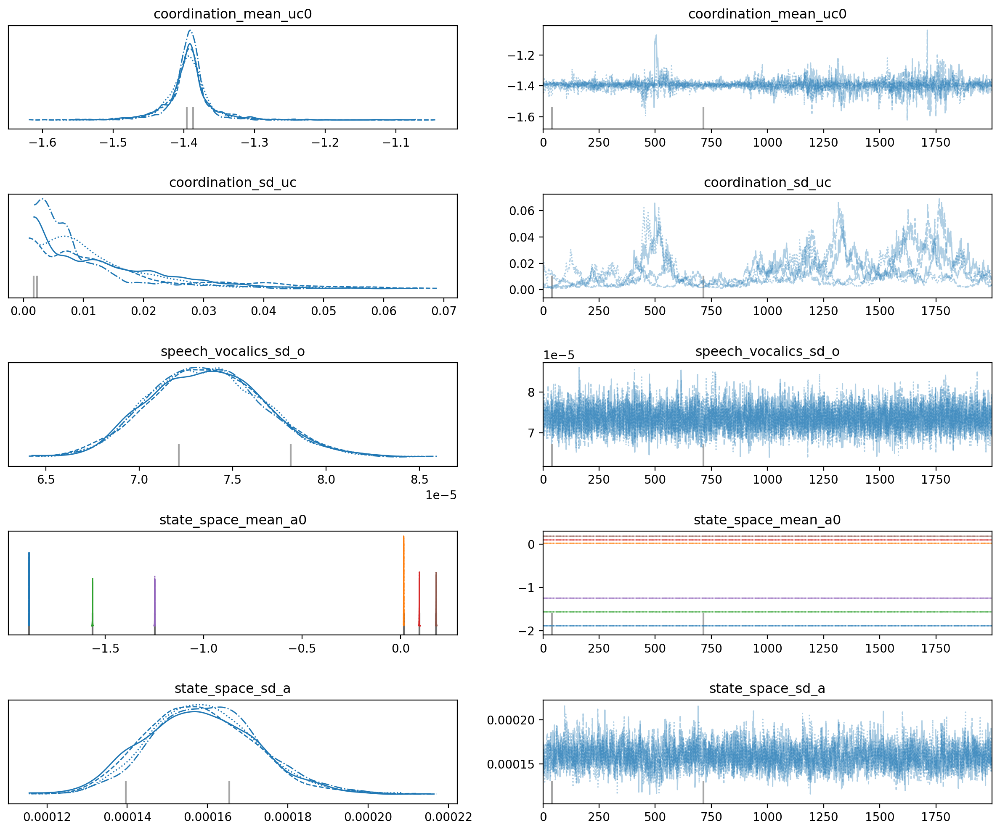

In [137]:
idata_i2 = train(model, burn_in=16000, recreate_variables=False)

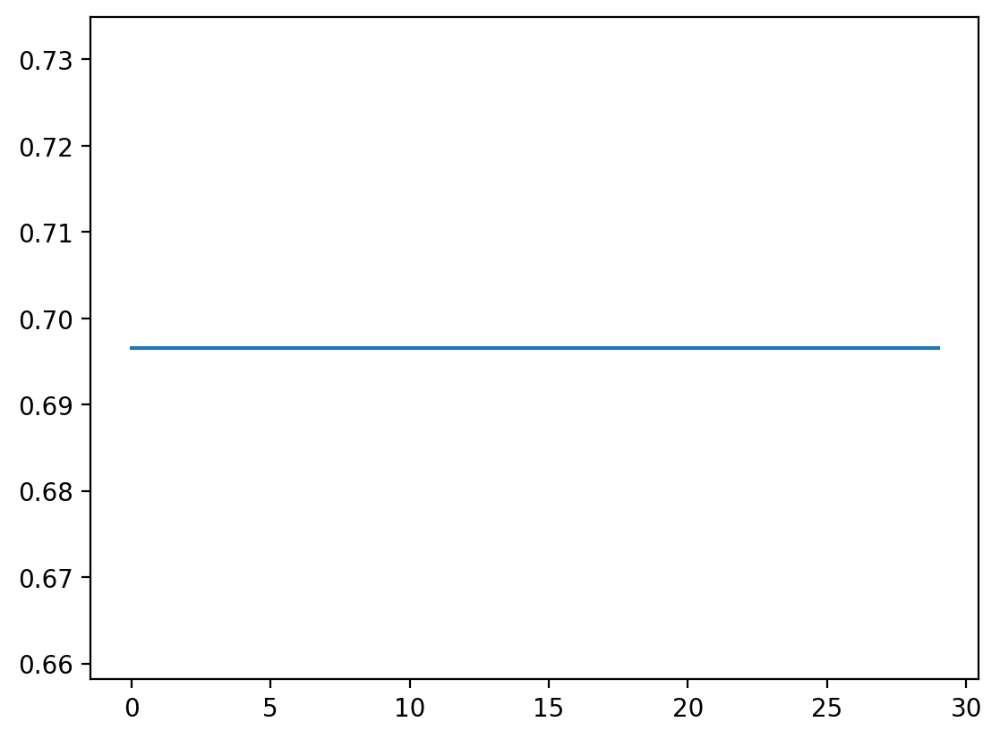

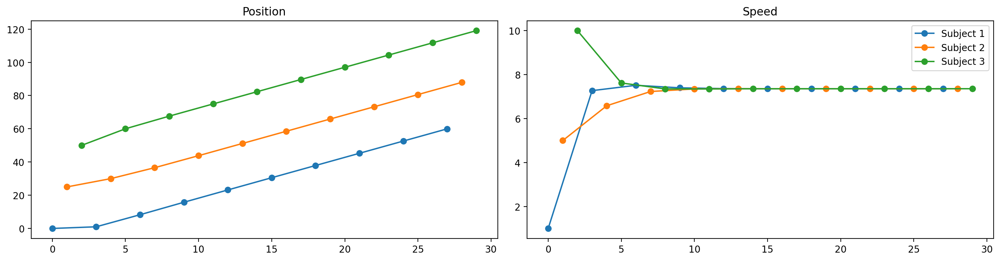

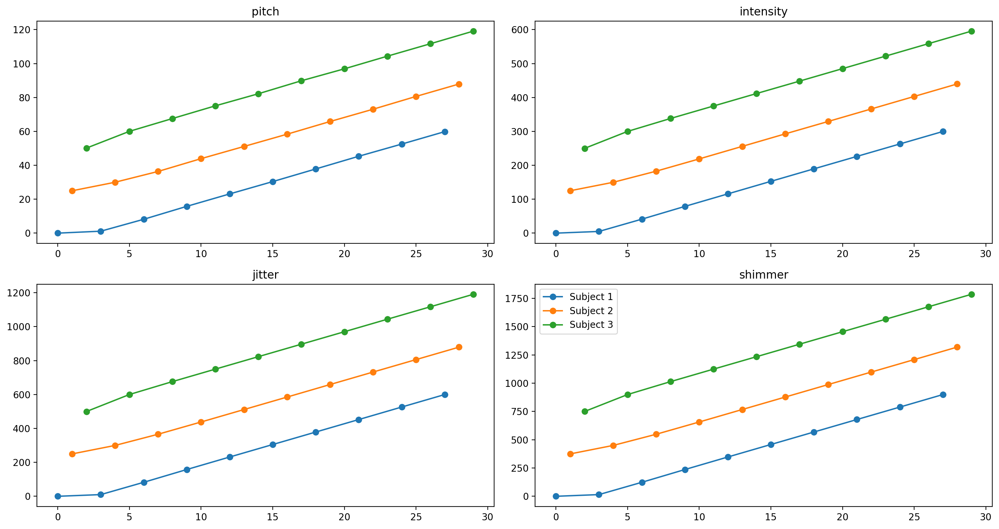

In [373]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0.8,
    noise=0
)
# bundle.sampling_time_scale_density = 0.2
bundle.mean_uc0 = 0
bundle.sd_uc = 1
bundle.alpha = 2
bundle.beta = 2
bundle.coordination_samples = None
bundle.constant_coordination = True
bundle.sd_a = 0
bundle.sd_o = 0.1
model = VocalicModel(bundle)
samples = model.draw_samples()
update_config_bundle_from_samples(bundle, samples)
# print(samples.coordination_samples.values[0])
# print(samples.component_group_samples["state_space"].values[0])
plt.plot(np.arange(len(samples.coordination_samples.values[0])), samples.coordination_samples.values[0])
plot_state_space(samples)
plot_observations(samples)

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
INFO:pymc:Multiprocess sampling (2 chains in 2 jobs)
NUTS: [single_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
INFO:pymc:NUTS: [single_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 659 seconds.
INFO:pymc:Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 659 seconds.


               variable converged  mean_rhat      std_rhat
0   state_space_mean_a0       yes   1.000842  8.631427e-04
1           state_space       yes   1.001280  1.167762e-03
2   single_coordination       yes   0.999799  0.000000e+00
3      state_space_sd_a       yes   1.045315  0.000000e+00
4  speech_vocalics_sd_o       yes   1.000694  0.000000e+00
5          coordination       yes   0.999799  2.220446e-16


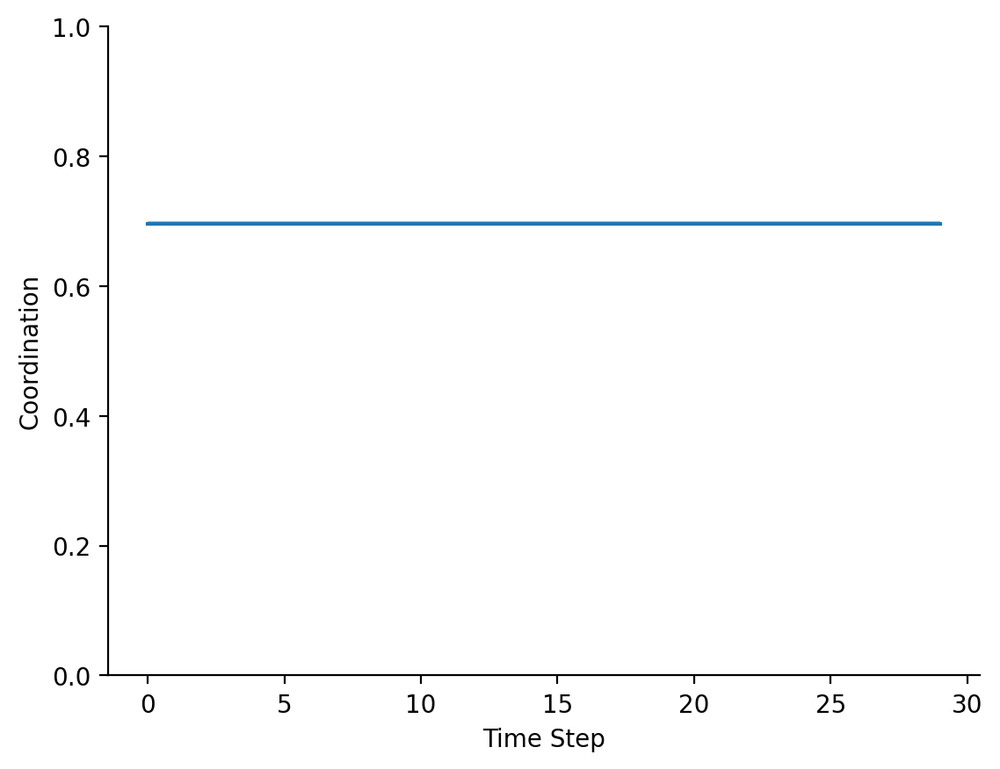

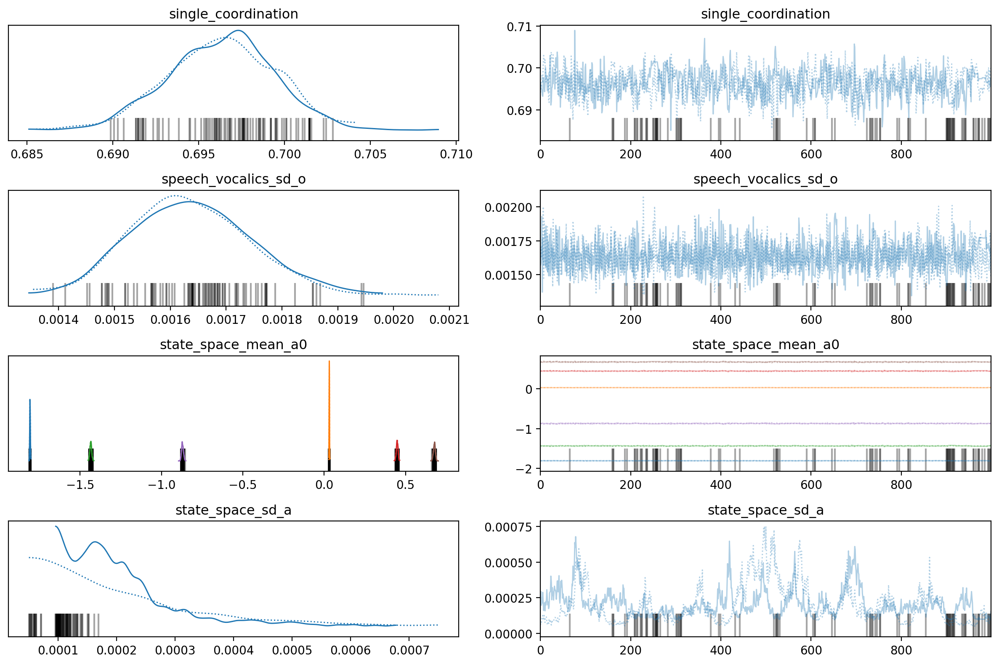

In [374]:
model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
# model.config_bundle.observed_coordination = 0.8
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used
idata_tmp = train(model, burn_in=1000, num_samples=1000, num_chains=2)

# Predictive power at time step t + 1

Only 100 samples in chain.
Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
INFO:pymc:Multiprocess sampling (2 chains in 2 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space]


Sampling 2 chains for 100 tune and 100 draw iterations (200 + 200 draws total) took 33 seconds.
INFO:pymc:Sampling 2 chains for 100 tune and 100 draw iterations (200 + 200 draws total) took 33 seconds.


                 variable converged  mean_rhat  std_rhat
0   coordination_mean_uc0       yes   1.046805  0.000000
1  unbounded_coordination       yes   1.027036  0.021260
2     state_space_mean_a0       yes   1.023230  0.005503
3             state_space       yes   1.011893  0.015568
4      coordination_sd_uc        no   1.112956  0.000000
5        state_space_sd_a        no   1.536790  0.189122
6            coordination       yes   1.026839  0.021383


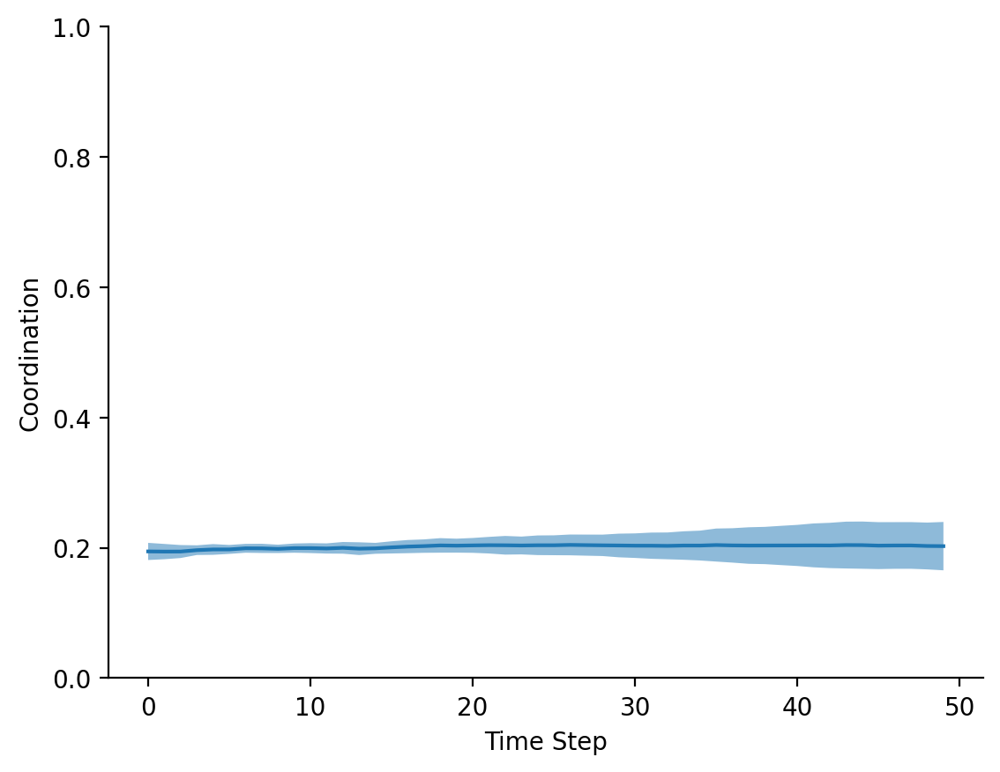

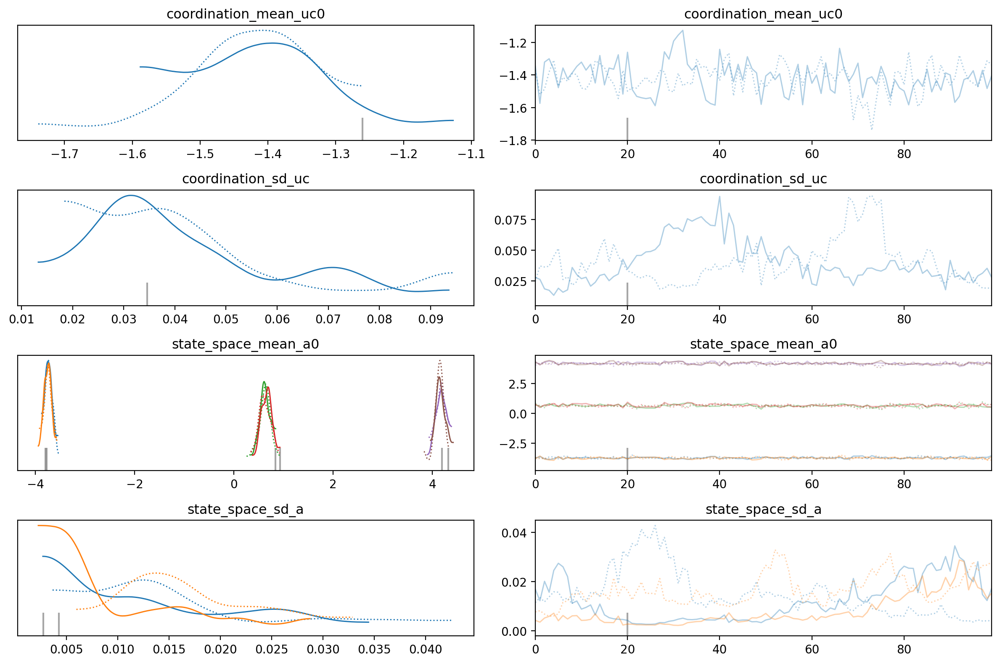

In [51]:
template_bundle_with_coordination = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.1
)
template_bundle_with_coordination.sd_a = 0.01

model = VocalicModel(deepcopy(template_bundle_with_coordination))
data_with_coordination = model.draw_samples()
update_config_bundle_from_samples(template_bundle_with_coordination, data_with_coordination)

template_bundle_no_coordination = configure_bundle(
    num_time_steps=100,
    coordination=0,
    noise=0.1,
)
template_bundle_no_coordination.sd_a = 0.01
model = VocalicModel(deepcopy(template_bundle_no_coordination))
data_no_coordination = model.draw_samples()
update_config_bundle_from_samples(template_bundle_no_coordination, data_no_coordination)

#--------------------------------------
model_with_coordination_on_data_with_coordination = VocalicModel(deepcopy(template_bundle_with_coordination))
model_with_coordination_on_data_with_no_coordination = VocalicModel(deepcopy(template_bundle_no_coordination))

model_with_no_coordination_on_data_with_coordination = VocalicModel(deepcopy(template_bundle_with_coordination))
model_with_no_coordination_on_data_with_coordination.config_bundle.observed_coordination = 0
model_with_no_coordination_on_data_with_coordination.config_bundle.constant_coordination = True

model_with_no_coordination_on_data_with_no_coordination = VocalicModel(deepcopy(template_bundle_no_coordination))
model_with_no_coordination_on_data_with_no_coordination.config_bundle.observed_coordination = 0
model_with_no_coordination_on_data_with_no_coordination.config_bundle.constant_coordination = True

models = [
    model_with_coordination_on_data_with_coordination,
    model_with_coordination_on_data_with_no_coordination,
    model_with_no_coordination_on_data_with_coordination,
    model_with_no_coordination_on_data_with_no_coordination
]

for model in models:
    model.config_bundle.sd_a = None
    model.config_bundle.mean_a0 = None
    model.config_bundle.mean_uc0 = None
    model.config_bundle.sd_uc = None
    model.config_bundle.num_time_steps_to_fit = 50
    model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used
    model._create_model_from_config_bundle()

    idata = train(model, num_chains=2, burn_in=100, num_samples=100)
#     # posterior_config_bundle = model.new_config_bundle_from_posterior_samples(
#     #     config_bundle=model.config_bundle,
#     #     idata=idata,
#     #     num_samples=100
#     # )
    break

In [14]:
idata.trace

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data